In [25]:
import pandas as pd
import numpy as np

import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# Read Data - Crime, House Price, Suburbs

In [26]:
file_path = filepath = "../Dataset/"
crime_df = pd.read_csv(file_path + "Clean/crime_stats_2013_2025.csv", encoding='utf-8', header=0)
crime_df.head()

,report_date,suburb,postcode,offence_lv1,offence_lv2,offence_lv3,offence_count
0,1/07/2013,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,SERIOUS CRIMINAL TRESPASS,SCT - Non Residence,1.0
1,1/07/2013,ADELAIDE,5000,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Graffiti,2.0
2,1/07/2013,ADELAIDE,5000,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Other property damage and environmental,2.0
3,1/07/2013,ADELAIDE,5000,OFFENCES AGAINST PROPERTY,SERIOUS CRIMINAL TRESPASS,SCT - Non Residence,1.0
4,1/07/2013,ADELAIDE,5000,OFFENCES AGAINST PROPERTY,THEFT AND RELATED OFFENCES,Other theft,3.0


In [27]:
crime_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 984574 entries, 0 to 984573
Data columns (total 7 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   report_date    984574 non-null  object 
 1   suburb         984574 non-null  object 
 2   postcode       984574 non-null  object 
 3   offence_lv1    984574 non-null  object 
 4   offence_lv2    984574 non-null  object 
 5   offence_lv3    984574 non-null  object 
 6   offence_count  984574 non-null  float64
dtypes: float64(1), object(6)
memory usage: 52.6+ MB


In [28]:
house_price_df = pd.read_csv(file_path + "Clean/sa_house_price_2015_2025.csv", encoding='utf-8', header=0)
house_price_df.head()

,city,suburb,sales,median,median_change,year,quarter
0,ADELAIDE,ADELAIDE,6.0,757500.0,0.169884,2015,Q1
1,ADELAIDE,NORTH ADELAIDE,4.0,992500.0,-0.097727,2015,Q1
2,ADELAIDE HILLS,ALDGATE,17.0,685000.0,0.132231,2015,Q1
3,ADELAIDE HILLS,BALHANNAH,9.0,439000.0,0.310448,2015,Q1
4,ADELAIDE HILLS,BELAIR,18.0,595000.0,0.117371,2015,Q1


In [29]:
house_price_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15424 entries, 0 to 15423
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   city           15424 non-null  object 
 1   suburb         15424 non-null  object 
 2   sales          15424 non-null  float64
 3   median         15424 non-null  float64
 4   median_change  15424 non-null  float64
 5   year           15424 non-null  int64  
 6   quarter        15424 non-null  object 
dtypes: float64(3), int64(1), object(3)
memory usage: 843.6+ KB


In [30]:
gdf = gpd.read_file(filepath + "Adl_Suburbs/Suburbs_shp/Suburbs_GDA94.shp")
gdf.head()

,postcode,suburb,suburb_num,legalstart,shape_Leng,shape_Area,geometry
0,0872,AMATA,87206,NaT,0.258467,0.003273,"POLYGON ((131.21647 -26.11914, 131.14123 -26.1..."
1,0872,ANANGU PITJANTJATJARA YANKUNYTJATJARA,87205,NaT,16.039189,9.288721,"POLYGON ((132.97729 -25.99857, 133.05763 -25.9..."
2,0872,AYERS RANGE SOUTH,87202,2013-04-26,1.466853,0.117333,"POLYGON ((133.458 -25.99856, 133.45829 -26.004..."
3,0872,DE ROSE HILL,87201,2013-04-26,1.685683,0.167840,"POLYGON ((133.42463 -26.4087, 133.42602 -26.44..."
4,0872,IWANTJA,87209,NaT,0.143983,0.001144,"POLYGON ((133.30662 -26.9931, 133.30002 -26.99..."


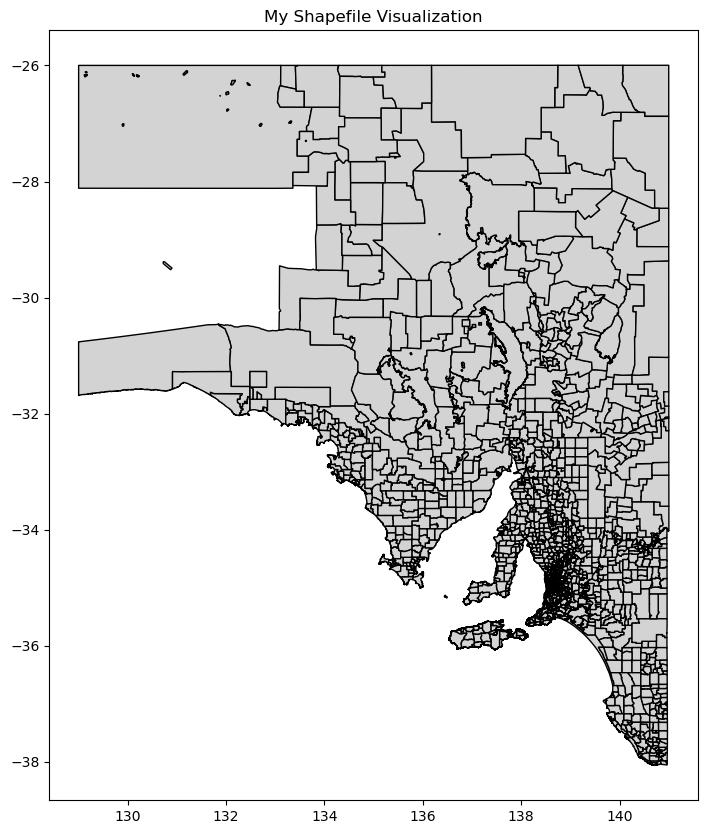

In [31]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(ax=ax, color='lightgray', edgecolor='black')
ax.set_title("My Shapefile Visualization")
plt.show()

# Integrate Crime, House Price and Suburb Data

In [32]:
def get_quarter(month):
    quarter = None
    if month <= 3:
        quarter = "Q1"
    elif month <= 6:
        quarter = "Q2"
    elif month <= 9:
        quarter = "Q3"
    elif month <= 12:
        quarter = "Q4"
    return quarter

# report date to datetime data
crime_clean_df = crime_df.copy()
crime_clean_df['report_date'] = crime_clean_df['report_date'].apply(lambda x: "0" + x if len(x)<10 else x)
crime_clean_df['report_date'] = pd.to_datetime(crime_clean_df['report_date'], format='%d/%m/%Y')

# extract quarter and year from crime data
crime_clean_df['year'] = crime_clean_df['report_date'].dt.year
crime_clean_df['month'] = crime_clean_df['report_date'].dt.month
crime_clean_df['quarter'] = crime_clean_df['month'].apply(lambda month: get_quarter(month))
crime_clean_df.drop(columns=['report_date', 'month'], inplace=True)

# only 2015 <= year <= 2024
print(f"Total crime data before select time frame: {len(crime_clean_df)}")
crime_clean_df = crime_clean_df[(crime_clean_df['year'] >= 2015) & (crime_clean_df['year'] <= 2024)]
print(f"Total crime data after select time frame 2015 <= year <= 2024: {len(crime_clean_df)}")

# remove whitespace
crime_clean_df['suburb'] = crime_clean_df['suburb'].str.strip()
crime_clean_df['postcode'] = crime_clean_df['postcode'].str.strip()

crime_clean_df
crime_clean_df.tail()

Total crime data before select time frame: 984574
Total crime data after select time frame 2015 <= year <= 2024: 827336


,suburb,postcode,offence_lv1,offence_lv2,offence_lv3,offence_count,year,quarter
960575,WINDSOR GARDENS,5087,OFFENCES AGAINST PROPERTY,THEFT AND RELATED OFFENCES,Other theft,1.0,2024,Q4
960576,WINDSOR GARDENS,5087,OFFENCES AGAINST PROPERTY,THEFT AND RELATED OFFENCES,Theft from shop,1.0,2024,Q4
960577,WINDSOR GARDENS,5087,OFFENCES AGAINST THE PERSON,ACTS INTENDED TO CAUSE INJURY,Common Assault,1.0,2024,Q4
960578,WONGULLA,5238,OFFENCES AGAINST PROPERTY,THEFT AND RELATED OFFENCES,Other theft,2.0,2024,Q4
960579,WOODVILLE NORTH,5012,OFFENCES AGAINST PROPERTY,THEFT AND RELATED OFFENCES,Other theft,1.0,2024,Q4


In [33]:
crime_clean_df.columns

Index(['suburb', 'postcode', 'offence_lv1', 'offence_lv2', 'offence_lv3',
       'offence_count', 'year', 'quarter'],
      dtype='object')

In [34]:
# group into year and quarter
crime_group_df = crime_clean_df.groupby(['year', 'quarter','suburb', 'postcode',
                                         'offence_lv1', 'offence_lv2', 'offence_lv3'])['offence_count'].sum()

crime_group_df = crime_group_df.reset_index()
print(f"Total crime data after grouping: {len(crime_group_df)}")
crime_group_df.head()

Total crime data after grouping: 210099


,year,quarter,suburb,postcode,offence_lv1,offence_lv2,offence_lv3,offence_count
0,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,FRAUD DECEPTION AND RELATED OFFENCES,Obtain benefit by deception,2.0
1,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Graffiti,11.0
2,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Other property damage and environmental,13.0
3,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Property damage by fire or explosion,2.0
4,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,SERIOUS CRIMINAL TRESPASS,Other unlawful entry with intent,2.0


In [35]:
crime_group_df['suburb'].nunique()

1802

In [36]:
# group into year and quarter
crime_group_lv1_df = crime_clean_df.groupby(['year', 'quarter','suburb', 'postcode',
                                         'offence_lv1'])['offence_count'].sum()

crime_group_lv1_df = crime_group_lv1_df.reset_index()
print(f"Total crime data level 1 after grouping: {len(crime_group_lv1_df)}")
crime_group_lv1_df.head()

Total crime data level 1 after grouping: 50804


,year,quarter,suburb,postcode,offence_lv1,offence_count
0,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,69.0
1,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST THE PERSON,17.0
2,2015,Q1,ADELAIDE,5000,OFFENCES AGAINST PROPERTY,977.0
3,2015,Q1,ADELAIDE,5000,OFFENCES AGAINST THE PERSON,431.0
4,2015,Q1,ADELAIDE AIRPORT,5024,OFFENCES AGAINST PROPERTY,1.0


In [37]:
# group into year and quarter
crime_group_all_df = crime_clean_df.groupby(['year', 'quarter','suburb', 'postcode'])['offence_count'].sum()

crime_group_all_df = crime_group_all_df.reset_index()
print(f"Total crime data after grouping: {len(crime_group_all_df)}")
crime_group_all_df.head()

Total crime data after grouping: 31764


,year,quarter,suburb,postcode,offence_count
0,2015,Q1,ABERFOYLE PARK,5159,86.0
1,2015,Q1,ADELAIDE,5000,1408.0
2,2015,Q1,ADELAIDE AIRPORT,5024,1.0
3,2015,Q1,ADELAIDE AIRPORT,5950,46.0
4,2015,Q1,ALBERT PARK,5014,29.0


In [38]:
# group into year
crime_group_all_year_df = crime_clean_df.groupby(['year', 'suburb', 'postcode'])['offence_count'].sum()

crime_group_all_year_df = crime_group_all_year_df.reset_index()
print(f"Total crime data after grouping: {len(crime_group_all_year_df)}")
crime_group_all_year_df.head()

Total crime data after grouping: 11986


,year,suburb,postcode,offence_count
0,2015,ABERFOYLE PARK,5159,328.0
1,2015,ADELAIDE,5000,5431.0
2,2015,ADELAIDE AIRPORT,5024,10.0
3,2015,ADELAIDE AIRPORT,5950,169.0
4,2015,ALAWOONA,5311,2.0


In [108]:
crime_group_all_year_df.describe()

,year,offence_count
count,11986.000000,11986.000000
mean,2019.445269,82.693976
std,2.803487,249.513174
min,2015.000000,1.000000
25%,2017.000000,2.000000
50%,2019.000000,9.000000
75%,2022.000000,74.000000
max,2024.000000,7738.000000


In [39]:
crime_clean_yq_df = crime_clean_df.copy()
crime_clean_yq_df['year_quarter'] = crime_clean_yq_df["year"].astype(str) + '-' + crime_clean_yq_df["quarter"]

# group into year_quarter
crime_yq_all_df = crime_clean_yq_df.groupby(['year_quarter', 'suburb', 'postcode'])['offence_count'].sum()

crime_yq_all_df = crime_yq_all_df.reset_index()
print(f"Total crime data after grouping: {len(crime_yq_all_df)}")
crime_yq_all_df.head()

Total crime data after grouping: 31764


,year_quarter,suburb,postcode,offence_count
0,2015-Q1,ABERFOYLE PARK,5159,86.0
1,2015-Q1,ADELAIDE,5000,1408.0
2,2015-Q1,ADELAIDE AIRPORT,5024,1.0
3,2015-Q1,ADELAIDE AIRPORT,5950,46.0
4,2015-Q1,ALBERT PARK,5014,29.0


In [40]:
# remove whitespace
house_price_clean_df = house_price_df.copy()
house_price_clean_df['suburb'] = house_price_clean_df['suburb'].str.strip()
house_price_clean_df['city'] = house_price_clean_df['city'].str.strip()

# cleaning city name
house_price_clean_df['city'] = house_price_clean_df['city'].replace('PORT ADEL ENFIELD', 'PORT ADELAIDE ENFIELD')
house_price_clean_df['city'] = house_price_clean_df['city'].replace('NORWD PAYNM ST PET', 'NORWOOD PAYNEHAM & ST PETERS')

# only 2015 <= year <= 2024
house_price_clean_df = house_price_clean_df[(house_price_clean_df['year'] >= 2015) & (house_price_clean_df['year'] <= 2024)]

In [41]:
house_price_clean_df['suburb'].nunique()

415

In [42]:
house_price_clean_df.columns

Index(['city', 'suburb', 'sales', 'median', 'median_change', 'year',
       'quarter'],
      dtype='object')

In [43]:
# group into year and quarter
print(f"Total house price data before grouping: {len(house_price_clean_df)}")
house_price_clean_df = (house_price_clean_df.groupby(['year','quarter','city', 'suburb'])
                        .agg({'sales': 'sum', 'median': 'mean'}))

house_price_clean_df = house_price_clean_df.reset_index()
print(f"Total crime data after grouping: {len(house_price_clean_df)}")
house_price_clean_df.head()

Total house price data before grouping: 15050
Total crime data after grouping: 15050


,year,quarter,city,suburb,sales,median
0,2015,Q1,ADELAIDE,ADELAIDE,6.0,757500.0
1,2015,Q1,ADELAIDE,NORTH ADELAIDE,4.0,992500.0
2,2015,Q1,ADELAIDE HILLS,ALDGATE,17.0,685000.0
3,2015,Q1,ADELAIDE HILLS,BALHANNAH,9.0,439000.0
4,2015,Q1,ADELAIDE HILLS,BELAIR,18.0,595000.0


In [44]:
house_price_year_clean_df = (house_price_clean_df.groupby(['year','city', 'suburb'])
                        .agg({'sales': 'sum', 'median': 'mean'}))

house_price_year_clean_df = house_price_year_clean_df.reset_index()
print(f"Total crime data after grouping: {len(house_price_year_clean_df)}")
house_price_year_clean_df.head()

Total crime data after grouping: 4109


,year,city,suburb,sales,median
0,2015,ADELAIDE,ADELAIDE,25.0,615625.0
1,2015,ADELAIDE,NORTH ADELAIDE,19.0,1212875.0
2,2015,ADELAIDE HILLS,ALDGATE,39.0,710312.5
3,2015,ADELAIDE HILLS,BALHANNAH,9.0,439000.0
4,2015,ADELAIDE HILLS,BELAIR,69.0,558875.0


In [45]:
house_price_yq_df = house_price_clean_df.copy()
house_price_yq_df['year_quarter'] = house_price_yq_df['year'].astype(str) + "-" + house_price_yq_df['quarter']
house_price_yq_df = (house_price_yq_df.groupby(['year_quarter','city', 'suburb'])
                        .agg({'sales': 'sum', 'median': 'mean'}))
house_price_yq_df = house_price_yq_df.reset_index()
print(f"Total crime data after grouping: {len(house_price_yq_df)}")
house_price_yq_df.head()

Total crime data after grouping: 15050


,year_quarter,city,suburb,sales,median
0,2015-Q1,ADELAIDE,ADELAIDE,6.0,757500.0
1,2015-Q1,ADELAIDE,NORTH ADELAIDE,4.0,992500.0
2,2015-Q1,ADELAIDE HILLS,ALDGATE,17.0,685000.0
3,2015-Q1,ADELAIDE HILLS,BALHANNAH,9.0,439000.0
4,2015-Q1,ADELAIDE HILLS,BELAIR,18.0,595000.0


# Explore Crime Data

In [46]:
print(f"Total Crime data by year and quarter records: {len(crime_group_df)}")

Total Crime data by year and quarter records: 210099


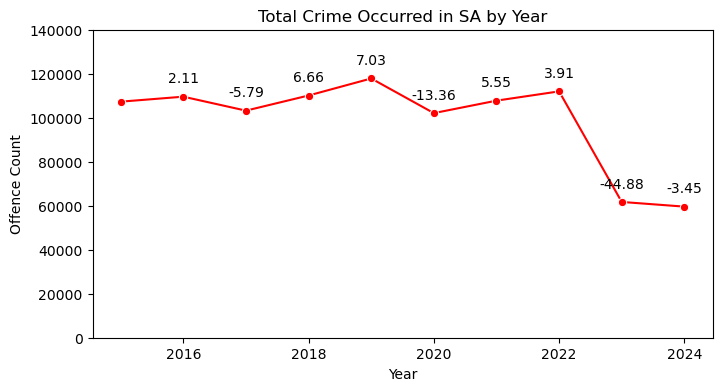

In [47]:
crime_year = crime_group_df.groupby(['year'])['offence_count'].sum().reset_index()
crime_year['percentage_change'] = crime_year['offence_count'].pct_change() * 100

plt.figure(figsize=(8, 4))
ax = sns.lineplot(x='year', y='offence_count', data=crime_year, color="red",marker='o')
for index, row in crime_year.iterrows():
    if index == 0:
        continue
    ax.annotate(f'{round(row["percentage_change"],2)}', 
                (row['year'], row['offence_count']), 
                textcoords="offset points", 
                xytext=(0,10), ha='center')
ax.set_ylim([0, 140000])
plt.ylabel("Offence Count")
plt.xlabel("Year")
plt.title("Total Crime Occurred in SA by Year")
plt.show()

In [48]:
# # Convert year and quarter to datetime for time-based plotting
# quarter_map = {'Q1': '01', 'Q2': '04', 'Q3': '07', 'Q4': '10'}
# df['quarter_start_month'] = df['quarter'].map(quarter_map)
# df['date'] = pd.to_datetime(df['year'].astype(str) + '-' + df['quarter_start_month'] + '-01')

# # Sort just in case
# df = df.sort_values(by='date')

# # Plot with seaborn
# plt.figure(figsize=(10, 6))
# sns.lineplot(data=df, x='date', y='value', hue='city', marker='o')

# # Beautify plot
# plt.title('Value Over Time by City')
# plt.xlabel('Date')
# plt.ylabel('Value')
# plt.xticks(rotation=45)
# plt.tight_layout()

plt.show()

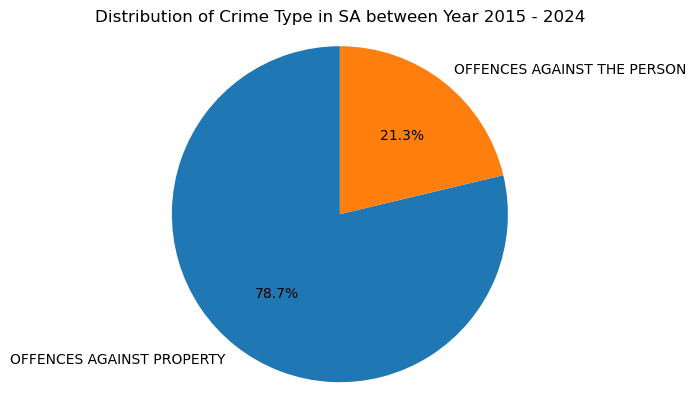

In [49]:
crime_lv1 = crime_group_df.groupby('offence_lv1')['offence_count'].sum().reset_index()
plt.pie(crime_lv1['offence_count'], labels=crime_lv1['offence_lv1'], autopct='%.1f%%',startangle=90)
plt.axis('equal') # Ensures the pie chart is drawn as a circle
plt.title('Distribution of Crime Type in SA between Year 2015 - 2024')
plt.show()

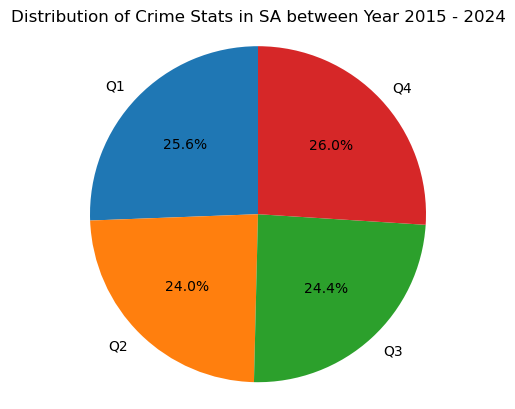

In [50]:
crime_quarter = crime_group_df.groupby(['quarter'])['offence_count'].sum().reset_index()
plt.pie(crime_quarter['offence_count'], labels=crime_quarter['quarter'], autopct='%.1f%%',startangle=90)
plt.axis('equal') # Ensures the pie chart is drawn as a circle
plt.title('Distribution of Crime Stats in SA between Year 2015 - 2024')
plt.show()

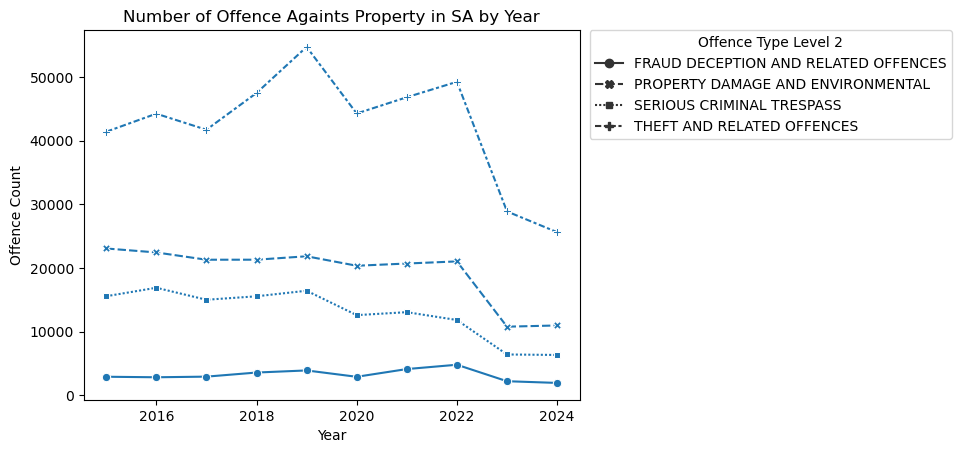

In [51]:
prop_crime_lv2 = (crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST PROPERTY')
                    .groupby(['year','offence_lv2'])['offence_count'].sum().reset_index())
sns.lineplot(data=prop_crime_lv2, x="year", y="offence_count", 
             style="offence_lv2", markers=True)

plt.ylabel("Offence Count")
plt.xlabel("Year")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='Offence Type Level 2')
plt.title("Number of Offence Againts Property in SA by Year")
plt.show()

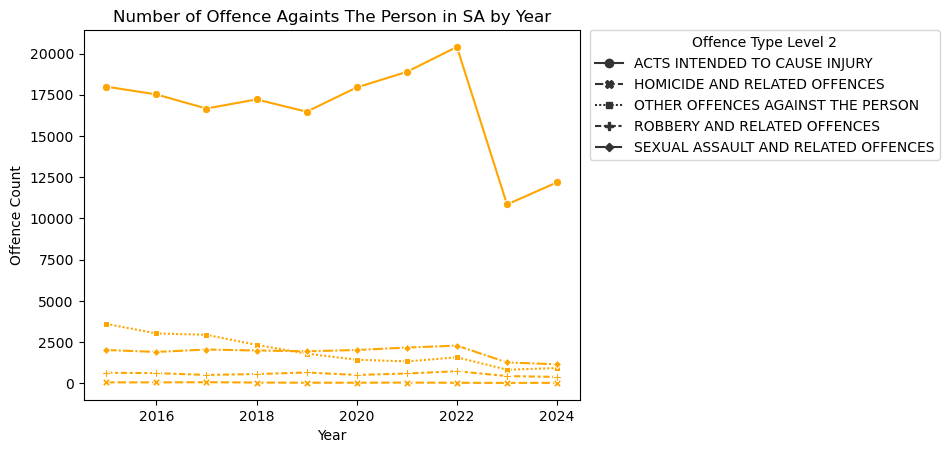

In [52]:
person_crime_lv2 = crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST THE PERSON').groupby(['year','offence_lv2'])['offence_count'].sum().reset_index()
sns.lineplot(data=person_crime_lv2, x="year", y="offence_count", 
             style="offence_lv2", color='orange', markers=True)

plt.ylabel("Offence Count")
plt.xlabel("Year")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='Offence Type Level 2')
plt.title("Number of Offence Againts The Person in SA by Year")
plt.show()

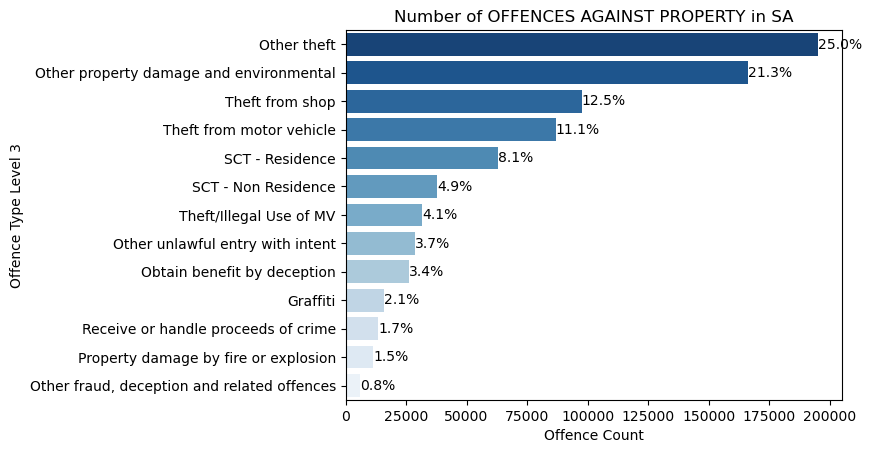

In [53]:
prop_crime_lv3 = (crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST PROPERTY')
                  .groupby(['offence_lv3'])['offence_count'].sum().reset_index())
prop_crime_lv3['pcnt_proportion'] = (prop_crime_lv3['offence_count'] / prop_crime_lv3['offence_count'].sum()) * 100
prop_crime_lv3 = prop_crime_lv3.sort_values(by='offence_count', ascending=False)
# plt.figure(figsize=(12, 6))

ax = sns.barplot(x='offence_count', y='offence_lv3', data=prop_crime_lv3,
                  orient="h", palette="Blues_r")
labels = [f'{val:.1f}%' for val in prop_crime_lv3['pcnt_proportion']]
for container in ax.containers:
        ax.bar_label(container, labels=labels, fmt='%.0f')


plt.ylabel("Offence Type Level 3")
plt.xlabel("Offence Count")
plt.title("Number of OFFENCES AGAINST PROPERTY in SA")
# plt.xticks(rotation=45, ha='right')
# plt.legend(title="Offence Type Level2")
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, title='Offence Type')
plt.show()

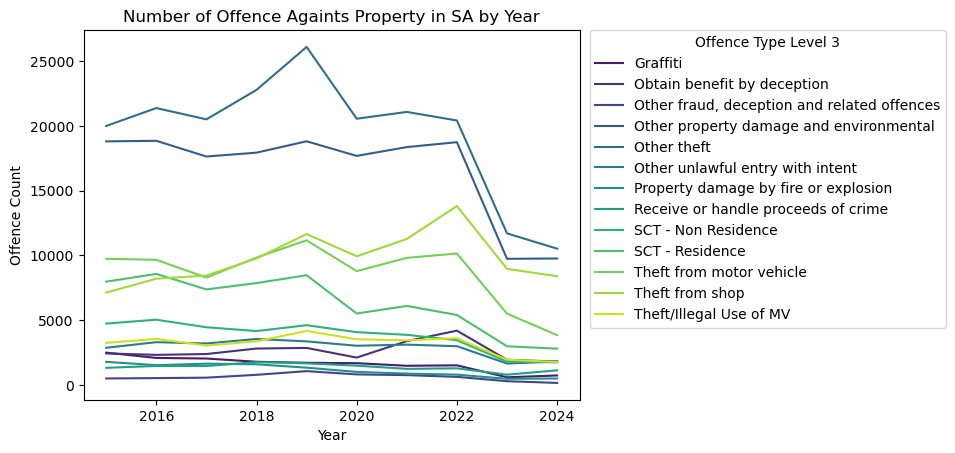

In [54]:
prop_crime_lv3_year = (crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST PROPERTY')
                    .groupby(['year','offence_lv3'])['offence_count'].sum().reset_index())
sns.lineplot(data=prop_crime_lv3_year, x="year", y="offence_count", 
             hue="offence_lv3", palette='viridis')

plt.ylabel("Offence Count")
plt.xlabel("Year")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='Offence Type Level 3')
plt.title("Number of Offence Againts Property in SA by Year")
plt.show()

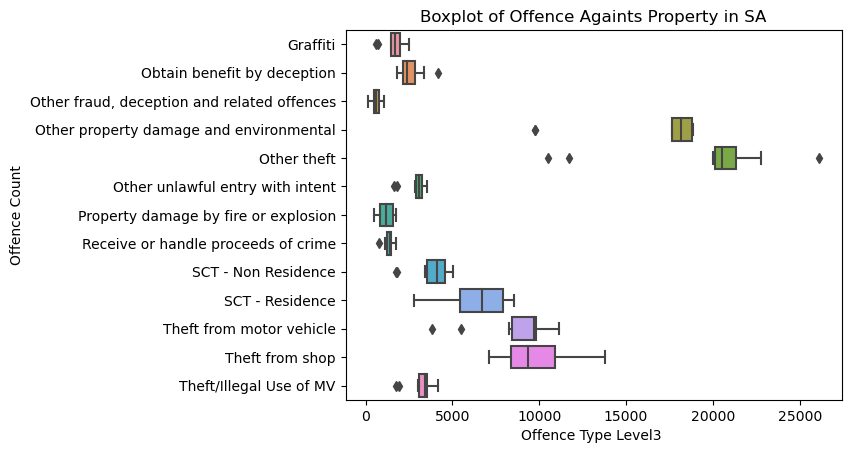

In [55]:
sns.boxplot(data=prop_crime_lv3_year, x="offence_count", y="offence_lv3")
plt.ylabel("Offence Count")
plt.xlabel("Offence Type Level3 ")
plt.title("Boxplot of Offence Againts Property in SA")
plt.show()

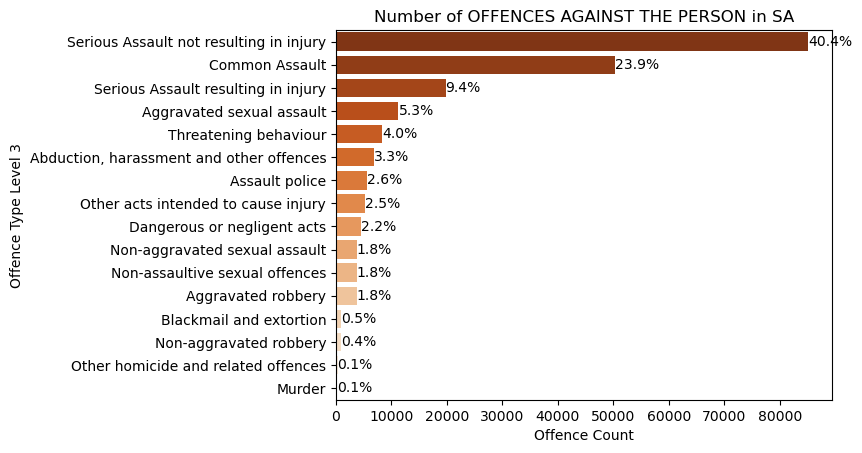

In [56]:
person_crime_lv3 = (crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST THE PERSON')
                  .groupby(['offence_lv3'])['offence_count'].sum().reset_index())
person_crime_lv3['pcnt_proportion'] = (person_crime_lv3['offence_count'] / person_crime_lv3['offence_count'].sum()) * 100
person_crime_lv3 = person_crime_lv3.sort_values(by='offence_count', ascending=False)

# plt.figure(figsize=(12, 6))
ax = sns.barplot(x='offence_count', y='offence_lv3', data=person_crime_lv3, 
                 orient="h", palette="Oranges_r")
labels = [f'{val:.1f}%' for val in person_crime_lv3['pcnt_proportion']]
for container in ax.containers:
        ax.bar_label(container, labels=labels, fmt='%.0f')


plt.ylabel("Offence Type Level 3")
plt.xlabel("Offence Count")
plt.title("Number of OFFENCES AGAINST THE PERSON in SA")
# plt.xticks(rotation=45, ha='right')
# plt.legend(title="Offence Type Level2")
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, title='Offence Type')
plt.show()

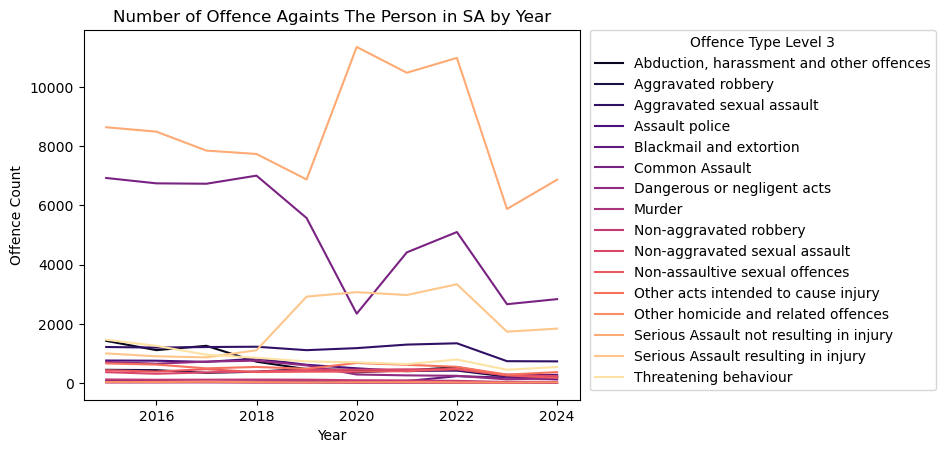

In [57]:
person_crime_lv3_year = (crime_group_df.where(crime_group_df['offence_lv1'] == 'OFFENCES AGAINST THE PERSON')
                    .groupby(['year','offence_lv3'])['offence_count'].sum().reset_index())
sns.lineplot(data=person_crime_lv3_year, x="year", y="offence_count", 
             hue="offence_lv3", palette='magma')

plt.ylabel("Offence Count")
plt.xlabel("Year")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, title='Offence Type Level 3')
plt.title("Number of Offence Againts The Person in SA by Year")
plt.show()

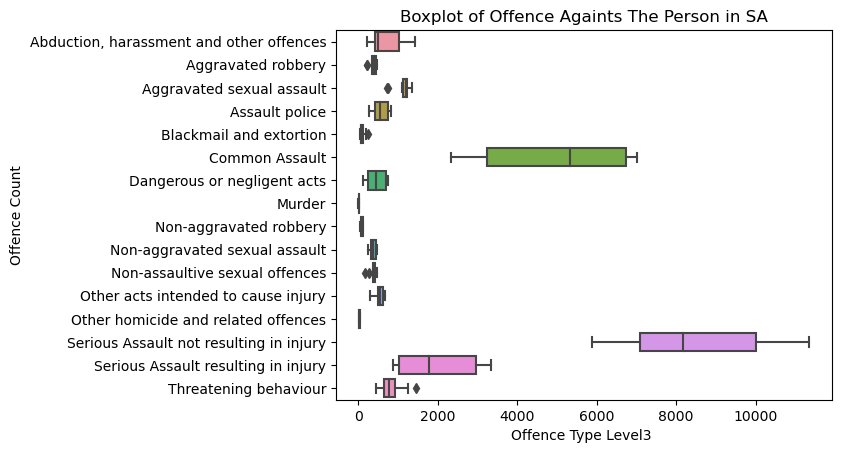

In [58]:
# plt.figure(figsize=(10, 10))
sns.boxplot(data=person_crime_lv3_year, x="offence_count", y="offence_lv3")
plt.ylabel("Offence Count")
plt.xlabel("Offence Type Level3 ")
plt.title("Boxplot of Offence Againts The Person in SA")
plt.show()

# Explore House Price

In [59]:
print(f"Total House Price data records: {len(house_price_clean_df)}")
house_price_clean_df.head()

Total House Price data records: 15050


,year,quarter,city,suburb,sales,median
0,2015,Q1,ADELAIDE,ADELAIDE,6.0,757500.0
1,2015,Q1,ADELAIDE,NORTH ADELAIDE,4.0,992500.0
2,2015,Q1,ADELAIDE HILLS,ALDGATE,17.0,685000.0
3,2015,Q1,ADELAIDE HILLS,BALHANNAH,9.0,439000.0
4,2015,Q1,ADELAIDE HILLS,BELAIR,18.0,595000.0


In [107]:
house_price_clean_df.describe()

,year,sales,median
count,15050.000000,15050.000000,1.505000e+04
mean,2019.507907,12.103455,7.200656e+05
std,2.864652,11.476348,4.093760e+05
min,2015.000000,1.000000,1.550000e+05
25%,2017.000000,5.000000,4.550000e+05
50%,2020.000000,9.000000,6.162500e+05
75%,2022.000000,16.000000,8.550000e+05
max,2024.000000,129.000000,7.000000e+06


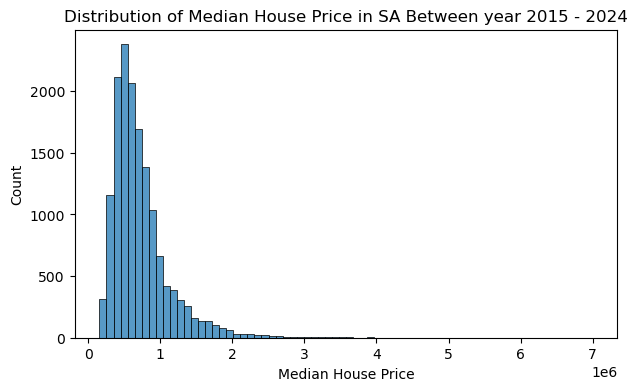

In [64]:
plt.figure(figsize=(7, 4))
sns.histplot(data=house_price_clean_df, x="median", bins=70)
plt.ylabel("Count")
plt.xlabel("Median House Price")
plt.title("Distribution of Median House Price in SA Between year 2015 - 2024")
plt.show()

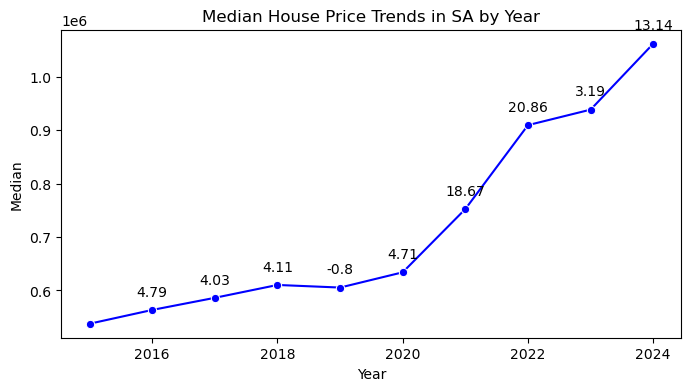

In [30]:
house_price_group_year = house_price_clean_df.groupby(['year'])['median'].mean().reset_index()
house_price_group_year['pcnt_change'] = house_price_group_year['median'].pct_change() * 100

plt.figure(figsize=(8, 4))
ax = sns.lineplot(x='year', y='median', data=house_price_group_year, color="blue",marker='o')
for index, row in house_price_group_year.iterrows():
    if index == 0:
        continue
    ax.annotate(f'{round(row["pcnt_change"],2)}', 
                (row['year'], row['median']), 
                textcoords="offset points", 
                xytext=(0,10), ha='center')

plt.ylabel("Median")
plt.xlabel("Year")
plt.title("Median House Price Trends in SA by Year")
plt.show()

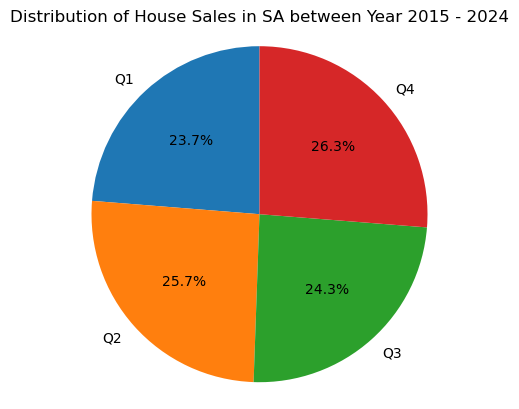

In [31]:
house_sales_quarter = house_price_clean_df.groupby(['quarter'])['sales'].sum().reset_index()
plt.pie(house_sales_quarter['sales'], labels=house_sales_quarter['quarter'], autopct='%.1f%%',startangle=90)
plt.axis('equal') # Ensures the pie chart is drawn as a circle
plt.title('Distribution of House Sales in SA between Year 2015 - 2024')
plt.show()

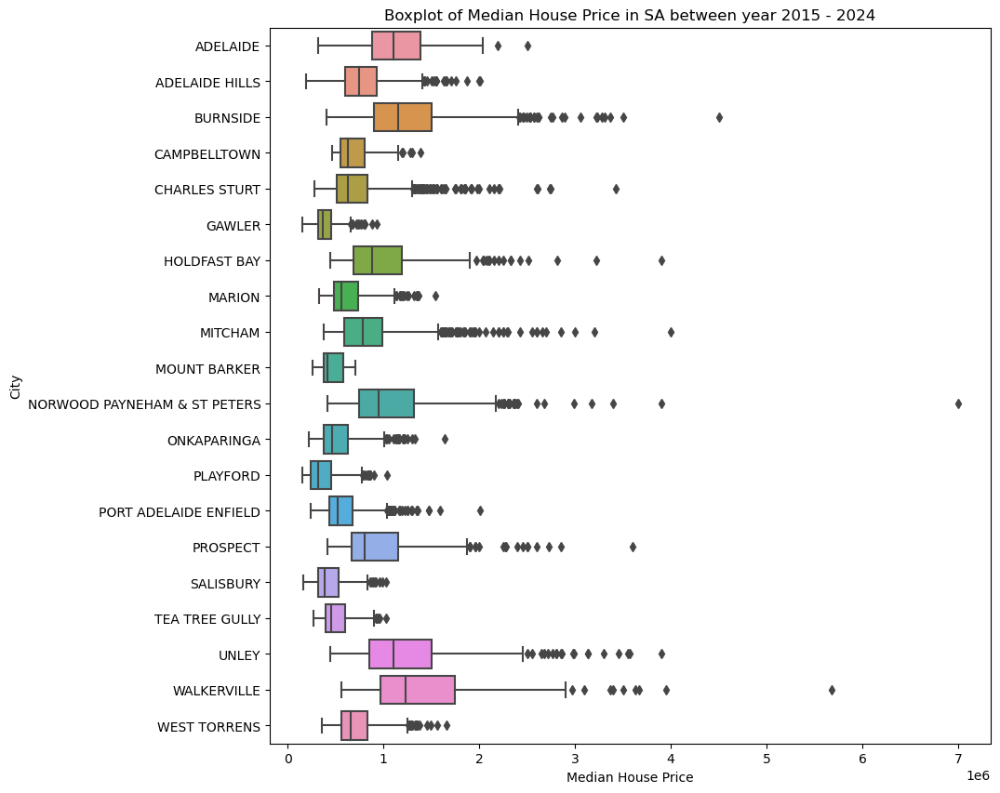

In [65]:
plt.figure(figsize=(10, 10))
sns.boxplot(data=house_price_clean_df, x="median", y="city")
plt.ylabel("City")
plt.xlabel("Median House Price")
plt.title("Boxplot of Median House Price in SA between year 2015 - 2024")
plt.show()

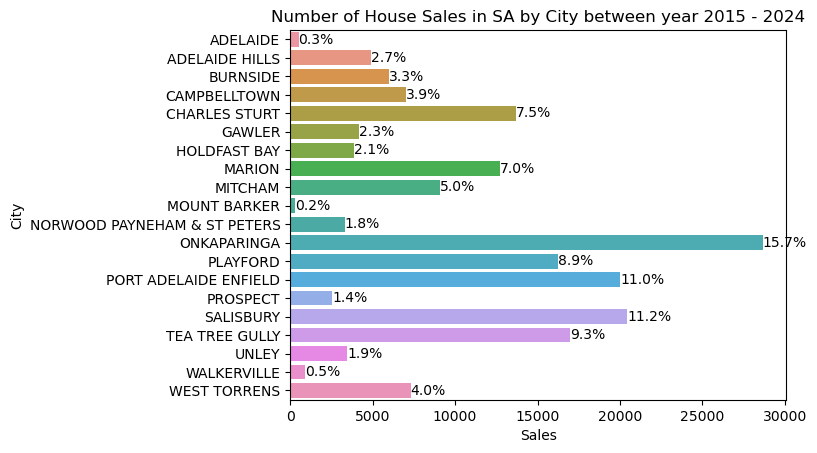

In [66]:
house_sales = (house_price_clean_df
                  .groupby(['city'])['sales'].sum().reset_index())
house_sales['pcnt_proportion'] = (house_sales['sales'] / house_sales['sales'].sum()) * 100

# plt.figure(figsize=(12, 6))
ax = sns.barplot(x='sales', y='city', data=house_sales, 
                 orient="h")
labels = [f'{val:.1f}%' for val in house_sales['pcnt_proportion']]
for container in ax.containers:
        ax.bar_label(container, labels=labels, fmt='%.0f')


plt.ylabel("City")
plt.xlabel("Sales")
plt.title("Number of House Sales in SA by City between year 2015 - 2024")
plt.show()

In [ ]:
# unique_city_suburbs = house_price_clean_df[['city', 'suburb']].drop_duplicates()
# len(unique_city_suburbs)

466

In [ ]:
# unique_city_suburbs.to_csv("../Dataset/Clean/house_price_city_suburb_dict.csv", index=False, header=True, encoding="utf-8")

# Ingrated Data 

All level Crime + House Price

In [67]:
merged_crime_house_df = pd.merge(crime_group_df, house_price_clean_df, on=['year', 'quarter', 'suburb'], how='outer')
print(f"Total merge: {len(merged_crime_house_df)}")

Total merge: 225436


In [68]:
merged_crime_house_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225436 entries, 0 to 225435
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   year           225436 non-null  int64  
 1   quarter        225436 non-null  object 
 2   suburb         225436 non-null  object 
 3   postcode       223828 non-null  object 
 4   offence_lv1    223828 non-null  object 
 5   offence_lv2    223828 non-null  object 
 6   offence_lv3    223828 non-null  object 
 7   offence_count  223828 non-null  float64
 8   city           152124 non-null  object 
 9   sales          152124 non-null  float64
 10  median         152124 non-null  float64
dtypes: float64(3), int64(1), object(7)
memory usage: 18.9+ MB


In [69]:
merged_crime_house_df.dropna(inplace=True)
print("Total records after drop null: ", len(merged_crime_house_df))

Total records after drop null:  150516


In [70]:
merged_crime_house_df.describe()

,year,offence_count,sales,median
count,150516.000000,150516.000000,150516.000000,1.505160e+05
mean,2019.007620,5.235948,14.457493,6.294592e+05
std,2.676439,11.944818,13.050658,3.481149e+05
min,2015.000000,1.000000,1.000000,1.550000e+05
25%,2017.000000,1.000000,6.000000,4.090000e+05
50%,2019.000000,2.000000,11.000000,5.426250e+05
75%,2021.000000,5.000000,18.000000,7.480000e+05
max,2024.000000,559.000000,129.000000,7.000000e+06


In [71]:
merged_crime_house_df.head()

,year,quarter,suburb,postcode,offence_lv1,offence_lv2,offence_lv3,offence_count,city,sales,median
0,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,FRAUD DECEPTION AND RELATED OFFENCES,Obtain benefit by deception,2.0,ONKAPARINGA,47.0,361250.0
1,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Graffiti,11.0,ONKAPARINGA,47.0,361250.0
2,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Other property damage and environmental,13.0,ONKAPARINGA,47.0,361250.0
3,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,PROPERTY DAMAGE AND ENVIRONMENTAL,Property damage by fire or explosion,2.0,ONKAPARINGA,47.0,361250.0
4,2015,Q1,ABERFOYLE PARK,5159,OFFENCES AGAINST PROPERTY,SERIOUS CRIMINAL TRESPASS,Other unlawful entry with intent,2.0,ONKAPARINGA,47.0,361250.0


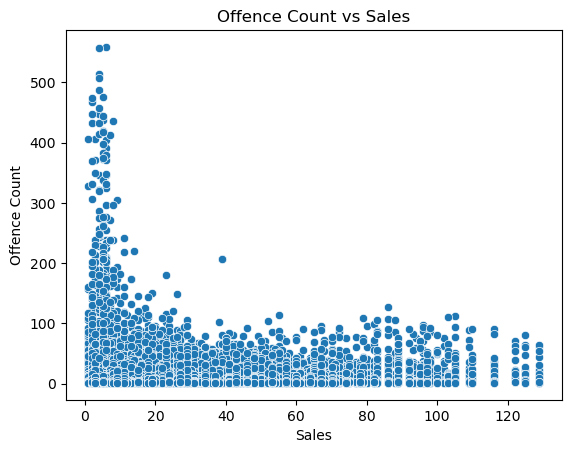

In [72]:
sns.scatterplot(x="sales", y="offence_count", data=merged_crime_house_df)
plt.ylabel("Offence Count")
plt.xlabel("Sales")
plt.title("Offence Count vs Sales")
plt.show()

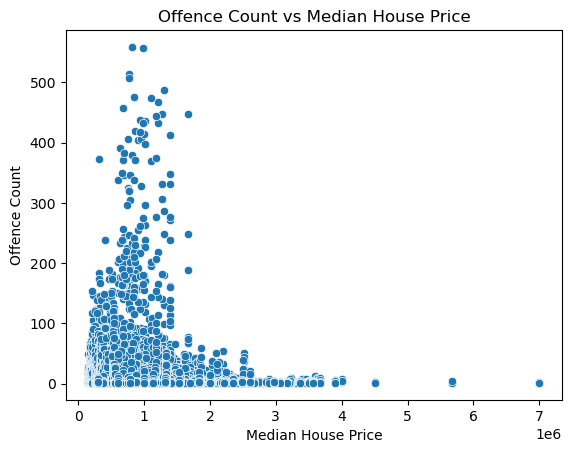

In [73]:
sns.scatterplot(x="median", y="offence_count", data=merged_crime_house_df)
plt.ylabel("Offence Count")
plt.xlabel("Median House Price")
plt.title("Offence Count vs Median House Price")
plt.show()

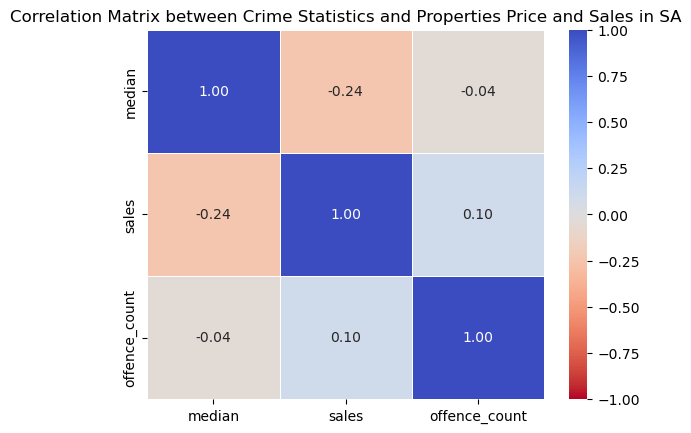

In [86]:
correlation_matrix = merged_crime_house_df[['median', 'sales', 'offence_count']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm_r', fmt=".2f", linewidths=.5, vmin=-1, vmax=1)
plt.title("Correlation Matrix between Crime Statistics and Properties Price and Sales in SA")
plt.show()

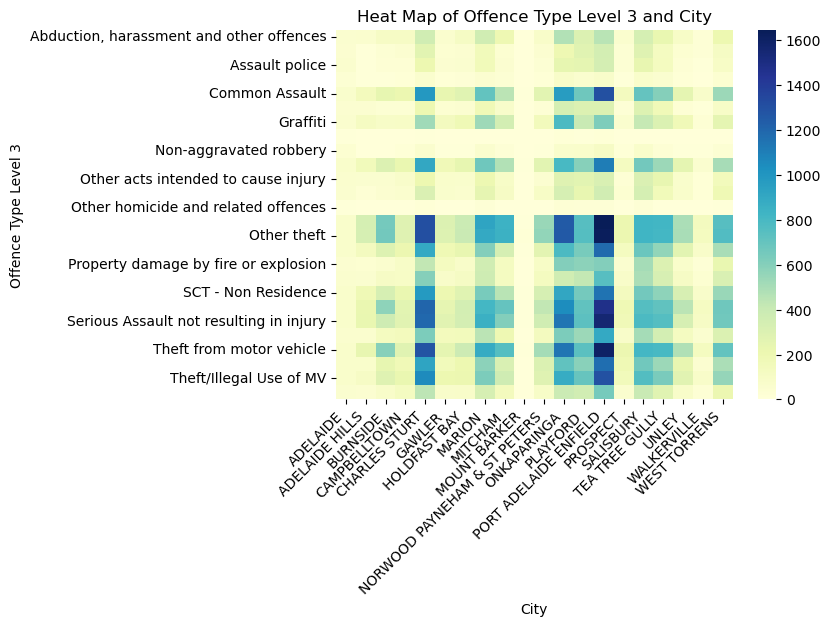

In [78]:
contingency_table = pd.crosstab(merged_crime_house_df['offence_lv3'], merged_crime_house_df['city'])
sns.heatmap(contingency_table,cmap="YlGnBu", cbar=True)
plt.xlabel('City')
plt.xticks(rotation=45, ha="right")
plt.ylabel("Offence Type Level 3")
plt.title("Heat Map of Offence Type Level 3 and City")
plt.show()

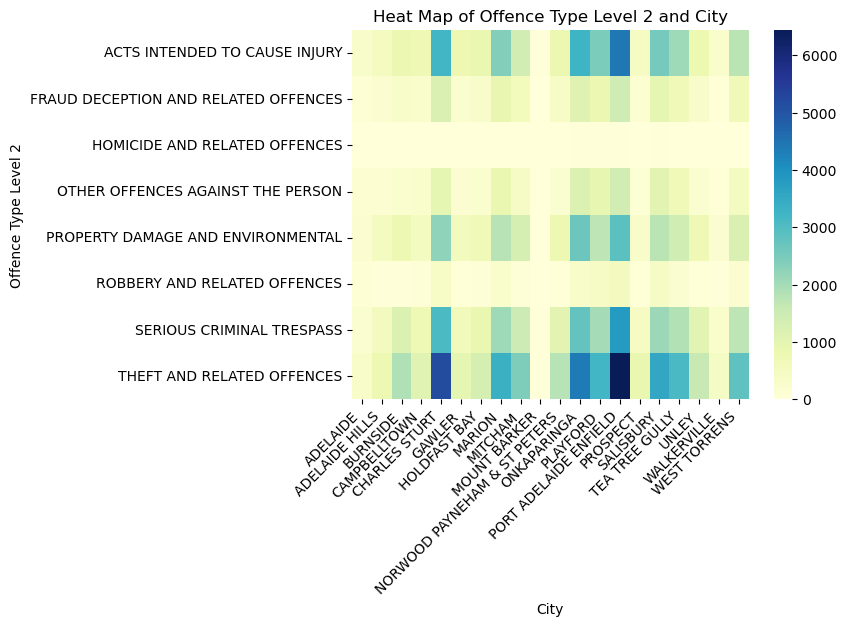

In [81]:
sns.heatmap(pd.crosstab(merged_crime_house_df['offence_lv2'], merged_crime_house_df['city']),cmap="YlGnBu", cbar=True)
plt.title("Heat Map of Offence Type Level 2 and City")
plt.xlabel('City')
plt.xticks(rotation=45, ha="right")
plt.ylabel("Offence Type Level 2")
plt.show()

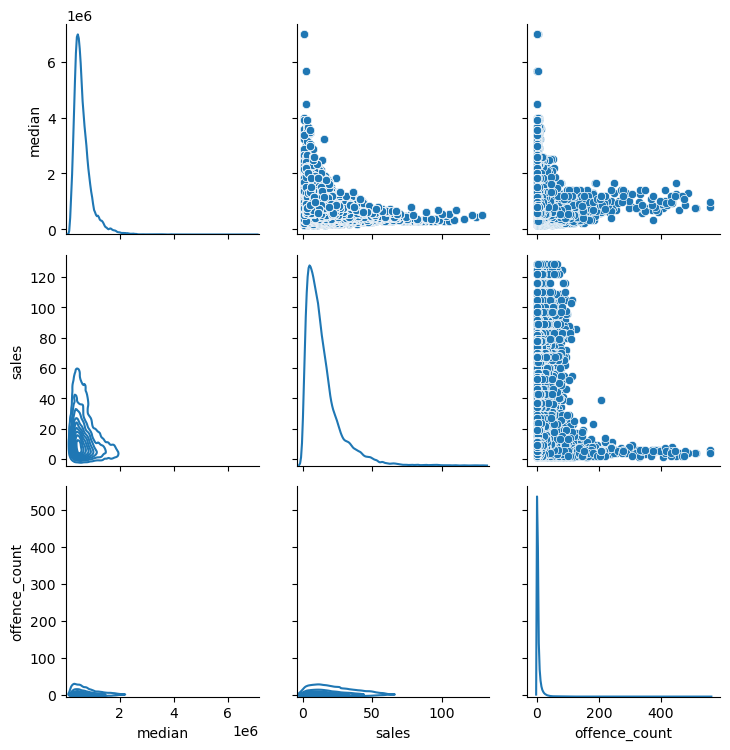

In [331]:
g = sns.PairGrid(merged_crime_house_df[['median', 'sales', 'offence_count']], diag_sharey=False)
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

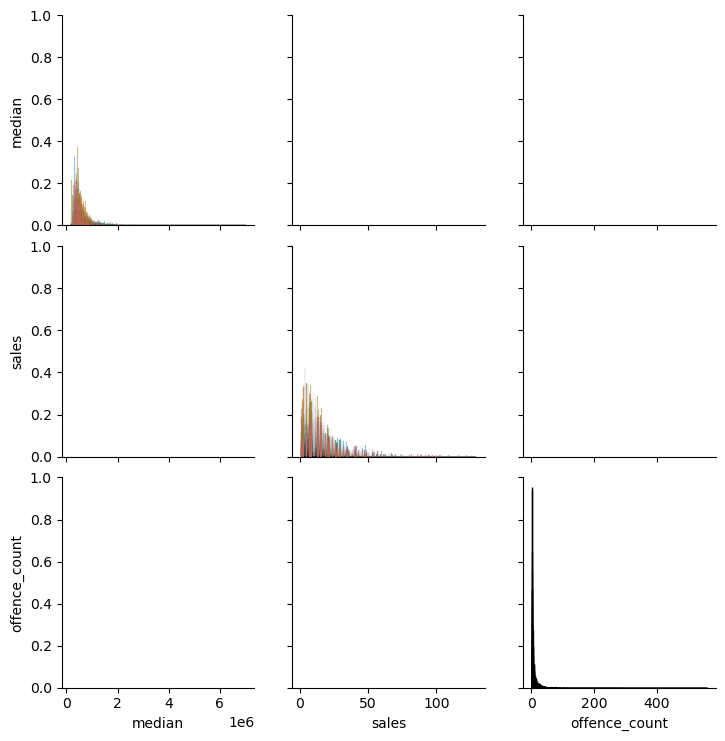

In [87]:
g = sns.PairGrid(merged_crime_house_df[['median', 'sales', 'offence_count', 'city']], hue="city")
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot, size=merged_crime_house_df["offence_count"])
g.add_legend(title="Histogram and Scatter Plot between Crime Statistics and House Price and Sales in SA", adjust_subtitles=True)

### Crime Level 1 + House Price

In [92]:
crime_group_lv1_df

merged_crime_lv1_house_df = pd.merge(crime_group_lv1_df, house_price_clean_df, on=['year', 'quarter', 'suburb'], how='inner')
print(f"Total merge: {len(merged_crime_lv1_house_df)}")

Total merge: 26009


In [93]:
merged_crime_lv1_house_df.describe()

,year,offence_count,sales,median
count,26009.000000,26009.000000,26009.000000,2.600900e+04
mean,2019.060633,30.300819,12.566342,6.739188e+05
std,2.678806,62.239284,11.598481,3.752765e+05
min,2015.000000,1.000000,1.000000,1.550000e+05
25%,2017.000000,5.000000,5.000000,4.350000e+05
50%,2019.000000,14.000000,9.000000,5.760000e+05
75%,2021.000000,35.000000,16.000000,8.000000e+05
max,2024.000000,1773.000000,129.000000,7.000000e+06


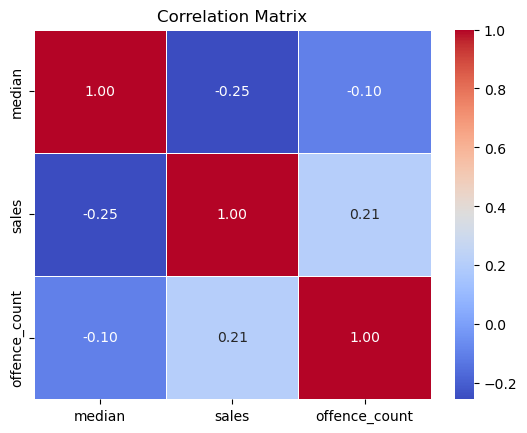

In [94]:
correlation_matrix_c_lv1_h = merged_crime_lv1_house_df[['median', 'sales', 'offence_count']].corr()
sns.heatmap(correlation_matrix_c_lv1_h, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title("Correlation Matrix")
plt.show()

### Crime All Level + House Price

In [95]:
merge_crime_all_house = pd.merge(crime_group_all_df, house_price_clean_df, on=['year', 'quarter', 'suburb'], how='inner')
print(f"Total merge: {len(merge_crime_all_house)}")

Total merge: 13662


In [96]:
merge_crime_all_house.describe()

,year,offence_count,sales,median
count,13662.000000,13662.000000,13662.000000,1.366200e+04
mean,2019.068292,57.685112,12.279827,6.872310e+05
std,2.671499,101.156643,11.504830,3.893002e+05
min,2015.000000,1.000000,1.000000,1.550000e+05
25%,2017.000000,17.000000,5.000000,4.385000e+05
50%,2019.000000,36.000000,9.000000,5.850000e+05
75%,2021.000000,68.000000,16.000000,8.173000e+05
max,2024.000000,2234.000000,129.000000,7.000000e+06


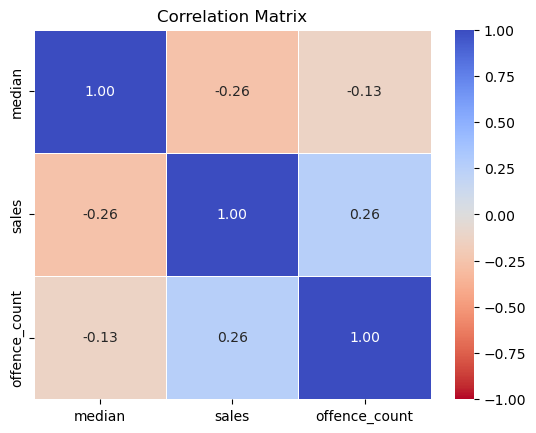

In [97]:
correlation_matrix_c_all_h = merge_crime_all_house[['median', 'sales', 'offence_count']].corr()
sns.heatmap(correlation_matrix_c_all_h, annot=True, cmap='coolwarm_r', fmt=".2f", linewidths=.5, vmin=-1, vmax=1)
plt.title("Correlation Matrix")
plt.show()

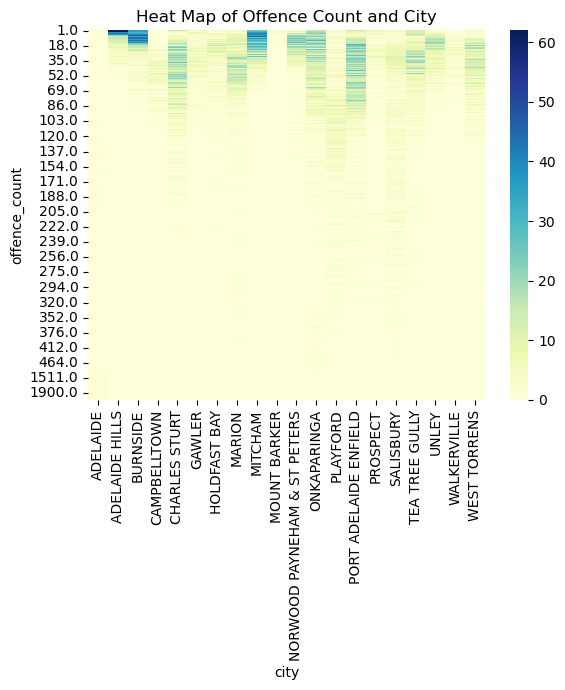

In [98]:
sns.heatmap(pd.crosstab(merge_crime_all_house['offence_count'], merge_crime_all_house['city']),cmap="YlGnBu", cbar=True)
plt.title("Heat Map of Offence Count and City")
plt.show()

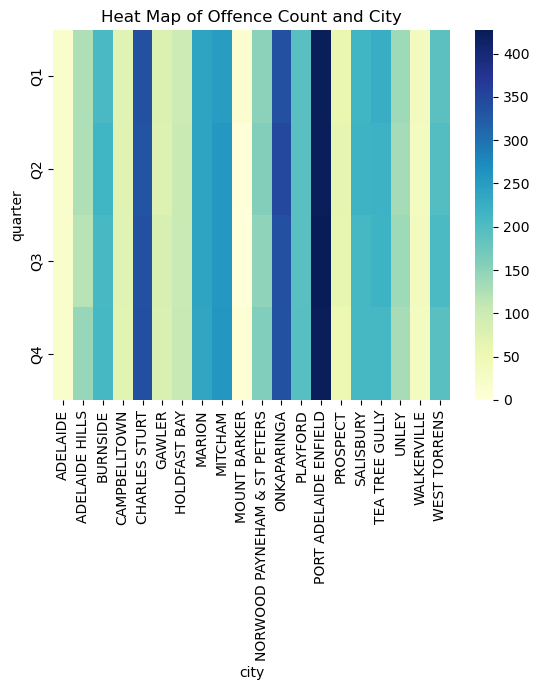

In [99]:
sns.heatmap(pd.crosstab(merge_crime_all_house['quarter'], merge_crime_all_house['city']),cmap="YlGnBu", cbar=True)
plt.title("Heat Map of Offence Count and City")
plt.show()

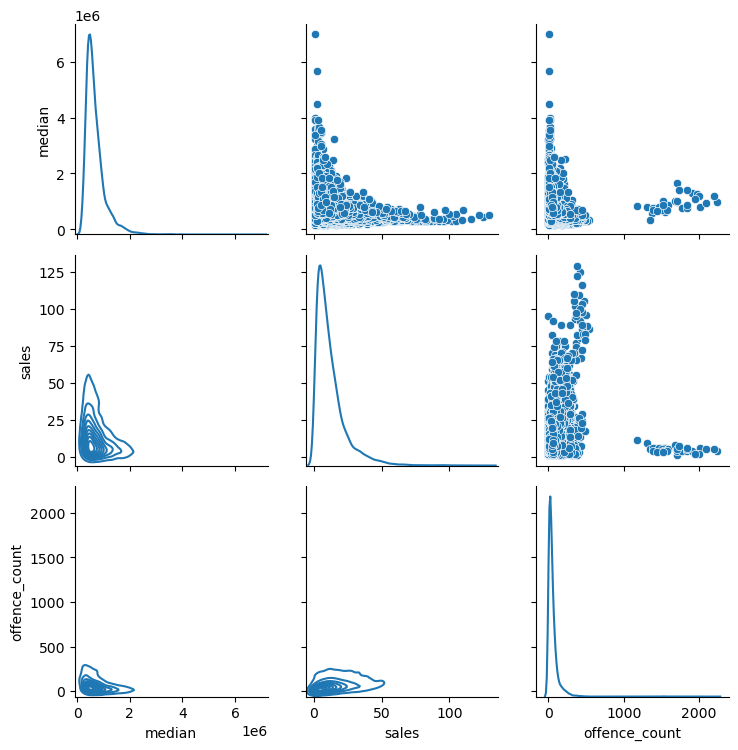

In [135]:
g = sns.PairGrid(merge_crime_all_house[['median', 'sales', 'offence_count']], diag_sharey=False)
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

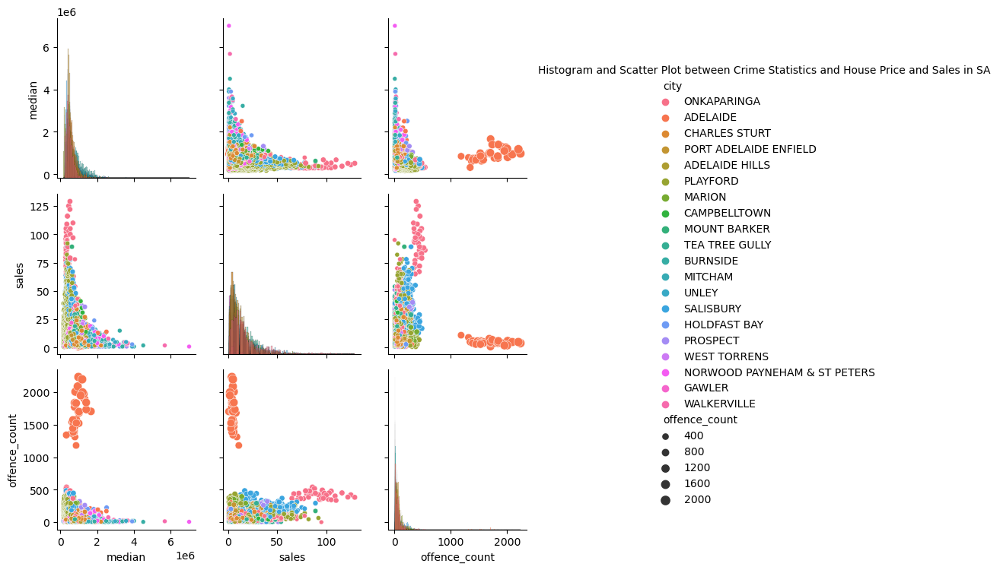

In [100]:
g = sns.PairGrid(merge_crime_all_house[['median', 'sales', 'offence_count', 'city']], hue="city")
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot, size=merge_crime_all_house["offence_count"])
g.add_legend(title="Histogram and Scatter Plot between Crime Statistics and House Price and Sales in SA", adjust_subtitles=True)

In [ ]:
sns.scatterplot(data=merge_crime_all_house,size=merge_crime_all_house["offence_count"])

In [101]:
# Convert year and quarter to datetime for sorting
quarter_map = {'Q1': 1, 'Q2': 4, 'Q3': 7, 'Q4': 10}
merge_crime_all_house_time = merge_crime_all_house.copy()
merge_crime_all_house_time['date'] = pd.to_datetime(merge_crime_all_house_time['year'].astype(str) + '-' + merge_crime_all_house_time['quarter'].map(quarter_map).astype(str) + '-01')
# Sort by city and date
merge_crime_all_house_time = merge_crime_all_house_time.sort_values(by=['city', 'suburb', 'date'])

# Get previous quarter value
merge_crime_all_house_time['offence_count_shift1'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['offence_count'].shift(1)
merge_crime_all_house_time['offence_count_shift2'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['offence_count'].shift(2)
merge_crime_all_house_time['offence_count_shift3'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['offence_count'].shift(3)
merge_crime_all_house_time['offence_count_shift4'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['offence_count'].shift(4)
merge_crime_all_house_time['offence_count_shift5'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['offence_count'].shift(5)
merge_crime_all_house_time['sales_shift1'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['sales'].shift(1)
merge_crime_all_house_time['sales_shift2'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['sales'].shift(2)
merge_crime_all_house_time['sales_shift3'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['sales'].shift(3)
merge_crime_all_house_time['sales_shift4'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['sales'].shift(4)
merge_crime_all_house_time['sales_shift5'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['sales'].shift(5)
merge_crime_all_house_time['median_shift1'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['median'].shift(1)
merge_crime_all_house_time['median_shift2'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['median'].shift(2)
merge_crime_all_house_time['median_shift3'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['median'].shift(3)
merge_crime_all_house_time['median_shift4'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['median'].shift(4)
merge_crime_all_house_time['median_shift5'] = merge_crime_all_house_time.groupby(['city', 'suburb'])['median'].shift(5)

# merge_crime_all_house_time['offence_count_pcnt_changed_shift1'] = np.where(merge_crime_all_house_time['offence_count_shift1'], 
#                                                                            merge_crime_all_house_time['offence_count_shift1'], np.nan)

# Drop the helper column if not needed
merge_crime_all_house_time = merge_crime_all_house_time.drop(columns='date')

In [102]:
merge_crime_all_house_time

,year,quarter,suburb,postcode,offence_count,city,sales,median,offence_count_shift1,offence_count_shift2,...,sales_shift1,sales_shift2,sales_shift3,sales_shift4,sales_shift5,median_shift1,median_shift2,median_shift3,median_shift4,median_shift5
1,2015,Q1,ADELAIDE,5000,1408.0,ADELAIDE,6.0,757500.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
393,2015,Q2,ADELAIDE,5000,1313.0,ADELAIDE,9.0,785000.0,1408.0,NaN,...,6.0,NaN,NaN,NaN,NaN,757500.0,NaN,NaN,NaN,NaN
760,2015,Q3,ADELAIDE,5000,1368.0,ADELAIDE,5.0,600000.0,1313.0,1408.0,...,9.0,6.0,NaN,NaN,NaN,785000.0,757500.0,NaN,NaN,NaN
1130,2015,Q4,ADELAIDE,5000,1342.0,ADELAIDE,5.0,320000.0,1368.0,1313.0,...,5.0,9.0,6.0,NaN,NaN,600000.0,785000.0,757500.0,NaN,NaN
1482,2016,Q1,ADELAIDE,5000,1520.0,ADELAIDE,3.0,750000.0,1342.0,1368.0,...,5.0,5.0,9.0,6.0,NaN,320000.0,600000.0,785000.0,757500.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11766,2022,Q3,WEST RICHMOND,5033,19.0,WEST TORRENS,4.0,745000.0,24.0,8.0,...,3.0,5.0,4.0,2.0,6.0,525000.0,680438.0,562000.0,485500.0,527500.0
12121,2022,Q4,WEST RICHMOND,5033,25.0,WEST TORRENS,6.0,733000.0,19.0,24.0,...,4.0,3.0,5.0,4.0,2.0,745000.0,525000.0,680438.0,562000.0,485500.0
12877,2023,Q2,WEST RICHMOND,5033,26.0,WEST TORRENS,3.0,580000.0,25.0,19.0,...,6.0,4.0,3.0,5.0,4.0,733000.0,745000.0,525000.0,680438.0,562000.0
13264,2024,Q3,WEST RICHMOND,5033,20.0,WEST TORRENS,2.0,752750.0,26.0,25.0,...,3.0,6.0,4.0,3.0,5.0,580000.0,733000.0,745000.0,525000.0,680438.0


In [103]:
merge_crime_all_house_time.select_dtypes(include='number').columns

Index(['year', 'offence_count', 'sales', 'median', 'offence_count_shift1',
       'offence_count_shift2', 'offence_count_shift3', 'offence_count_shift4',
       'offence_count_shift5', 'sales_shift1', 'sales_shift2', 'sales_shift3',
       'sales_shift4', 'sales_shift5', 'median_shift1', 'median_shift2',
       'median_shift3', 'median_shift4', 'median_shift5'],
      dtype='object')

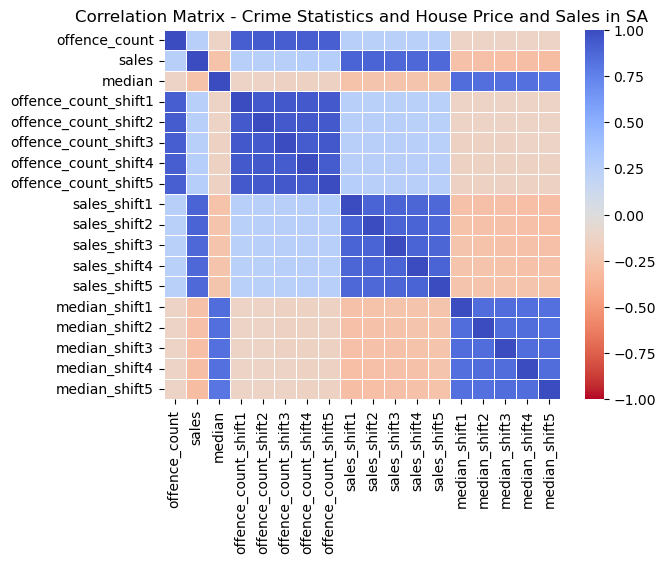

In [104]:
target_cols = ['offence_count', 'sales', 'median', 'offence_count_shift1',
       'offence_count_shift2', 'offence_count_shift3', 'offence_count_shift4',
       'offence_count_shift5', 'sales_shift1', 'sales_shift2', 'sales_shift3',
       'sales_shift4', 'sales_shift5', 'median_shift1', 'median_shift2',
       'median_shift3', 'median_shift4', 'median_shift5']
correlation_matrix_c_all_h_time = merge_crime_all_house_time[target_cols].corr()
sns.heatmap(correlation_matrix_c_all_h_time, cmap='coolwarm_r', fmt=".2f", linewidths=.5,vmin=-1, vmax=1)
plt.title("Correlation Matrix - Crime Statistics and House Price and Sales in SA")
plt.show()

### Crime + House Price: Year_Quarter

In [105]:
merge_crime_house_yq = pd.merge(crime_yq_all_df, house_price_yq_df, on=['year_quarter', 'suburb'], how='inner')
print(f"Total merge: {len(merge_crime_house_yq)}")

Total merge: 13662


### Crime + House Price: Year

In [106]:
merge_crime_house_year = pd.merge(crime_group_all_year_df, house_price_year_clean_df, on=['year', 'suburb'], how='inner')
print(f"Total merge: {len(merge_crime_house_year)}")

Total merge: 4222


# Integrate with Suburb Gropandas

<Axes: >

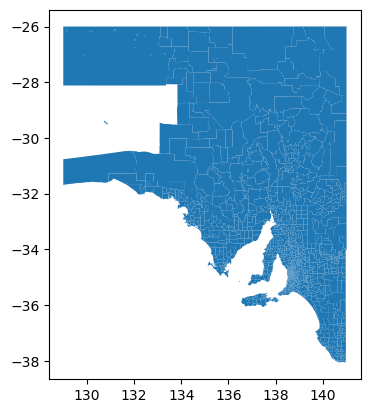

In [70]:
gdf.plot()

In [67]:
gdf_crime_house = gdf.merge(merge_crime_all_house, on=['postcode', 'suburb'], how="left")
gdf_crime_house.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 14930 entries, 0 to 14929
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   postcode       14930 non-null  object        
 1   suburb         14930 non-null  object        
 2   suburb_num     14930 non-null  int32         
 3   legalstart     14913 non-null  datetime64[ms]
 4   shape_Leng     14930 non-null  float64       
 5   shape_Area     14930 non-null  float64       
 6   geometry       14930 non-null  geometry      
 7   year           13442 non-null  float64       
 8   quarter        13442 non-null  object        
 9   offence_count  13442 non-null  float64       
 10  city           13442 non-null  object        
 11  sales          13442 non-null  float64       
 12  median         13442 non-null  float64       
dtypes: datetime64[ms](1), float64(6), geometry(1), int32(1), object(4)
memory usage: 1.4+ MB


In [68]:
print("Total records after merge: ", len(gdf_crime_house))

Total records after merge:  14930


In [72]:
gdf_crime_house.where(gdf_crime_house['year'] == 2024).explore()

In [75]:
import contextily as cx

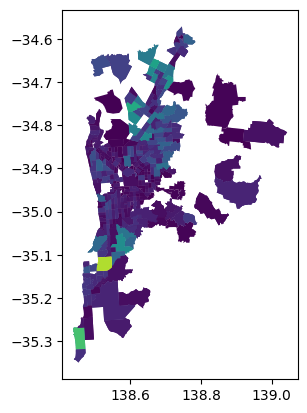

In [74]:
ax = gdf_crime_house.where(gdf_crime_house['year'] == 2024).plot(column='sales', missing_kwds={'color': 'lightgrey'})

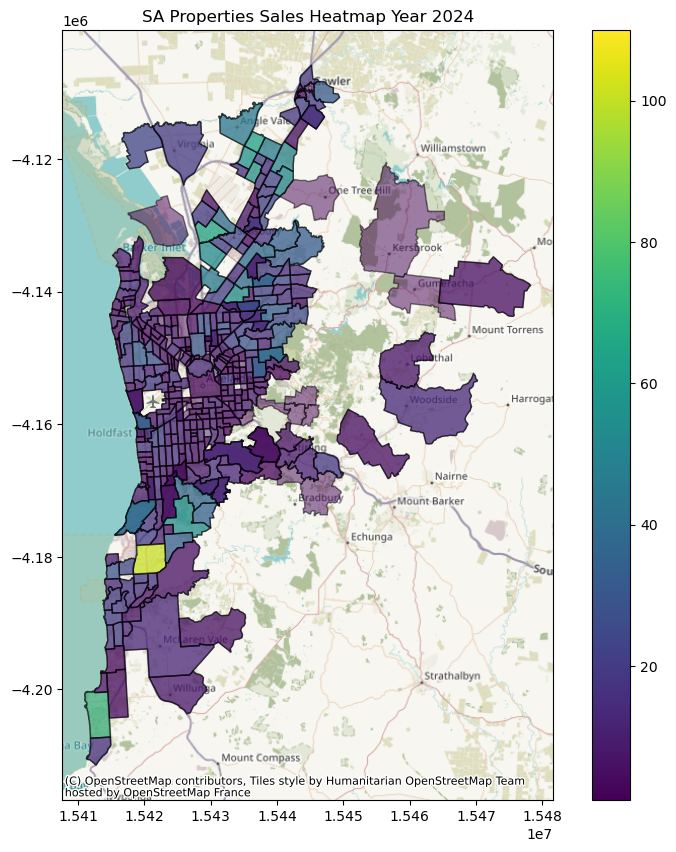

In [87]:
df_2024 = gdf_crime_house.where(gdf_crime_house['year'] == 2024).to_crs(epsg=3857)
ax = df_2024.plot(column='sales', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
plt.title("SA Properties Sales Heatmap Year 2024")
cx.add_basemap(ax)

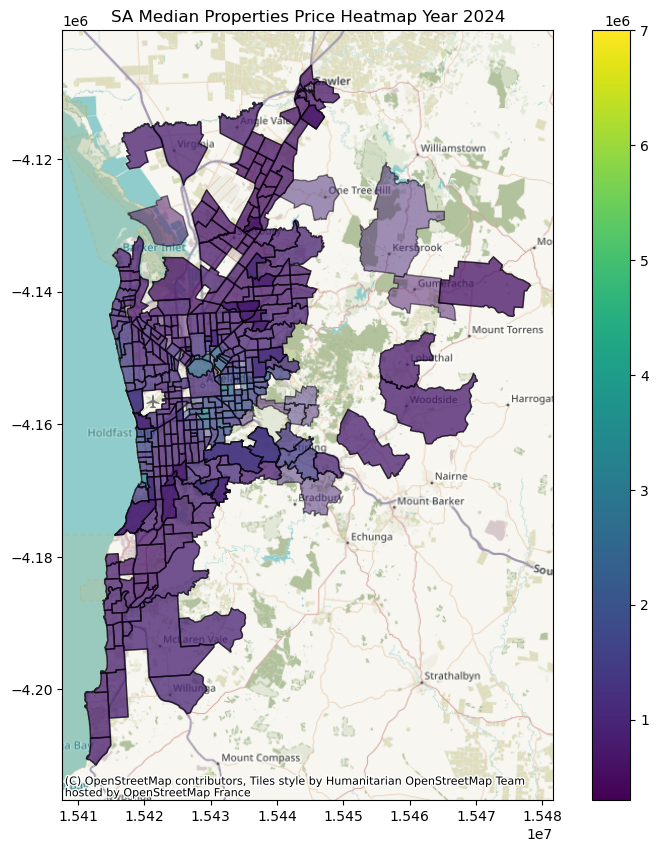

In [88]:
ax = df_2024.plot(column='median', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
plt.title("SA Median Properties Price Heatmap Year 2024")
cx.add_basemap(ax)

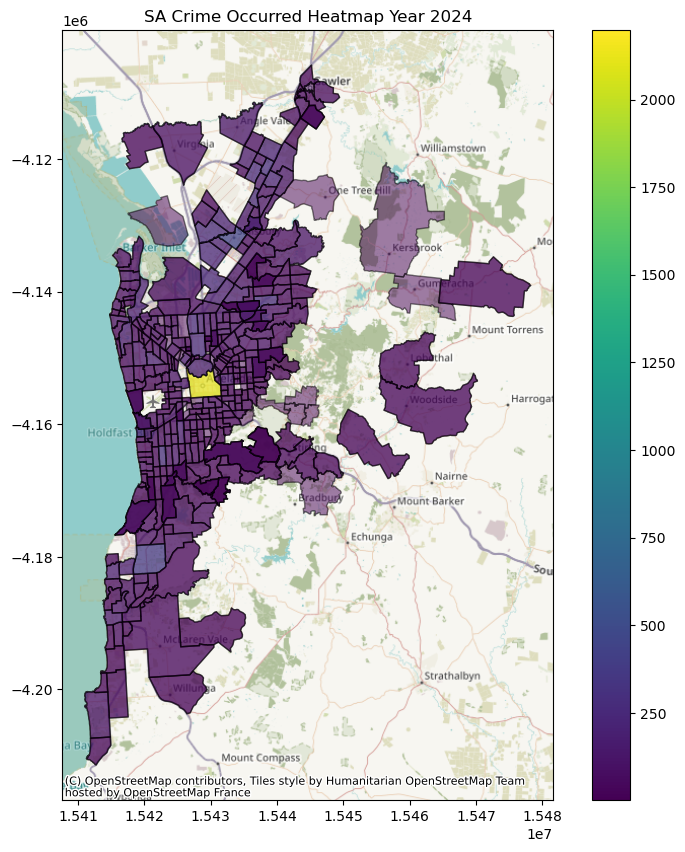

In [89]:
ax = df_2024.plot(column='offence_count', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
plt.title("SA Crime Occurred Heatmap Year 2024")
cx.add_basemap(ax)

In [98]:
gdf_crime_house_yq = gdf.merge(merge_crime_house_yq, on=['postcode', 'suburb'], how="left")
gdf_crime_house_yq.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 14930 entries, 0 to 14929
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   postcode       14930 non-null  object        
 1   suburb         14930 non-null  object        
 2   suburb_num     14930 non-null  int32         
 3   legalstart     14913 non-null  datetime64[ms]
 4   shape_Leng     14930 non-null  float64       
 5   shape_Area     14930 non-null  float64       
 6   geometry       14930 non-null  geometry      
 7   year_quarter   13442 non-null  object        
 8   offence_count  13442 non-null  float64       
 9   city           13442 non-null  object        
 10  sales          13442 non-null  float64       
 11  median         13442 non-null  float64       
dtypes: datetime64[ms](1), float64(5), geometry(1), int32(1), object(4)
memory usage: 1.3+ MB


In [112]:
gdf_crime_house_year = gdf.merge(merge_crime_house_year, on=['postcode', 'suburb'], how="inner")
gdf_crime_house_year.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4097 entries, 0 to 4096
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   postcode       4097 non-null   object        
 1   suburb         4097 non-null   object        
 2   suburb_num     4097 non-null   int32         
 3   legalstart     4097 non-null   datetime64[ms]
 4   shape_Leng     4097 non-null   float64       
 5   shape_Area     4097 non-null   float64       
 6   geometry       4097 non-null   geometry      
 7   year           4097 non-null   int32         
 8   offence_count  4097 non-null   float64       
 9   city           4097 non-null   object        
 10  sales          4097 non-null   float64       
 11  median         4097 non-null   float64       
dtypes: datetime64[ms](1), float64(5), geometry(1), int32(2), object(3)
memory usage: 352.2+ KB


In [114]:
years = gdf_crime_house_year['year'].unique()
years

array([2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024])

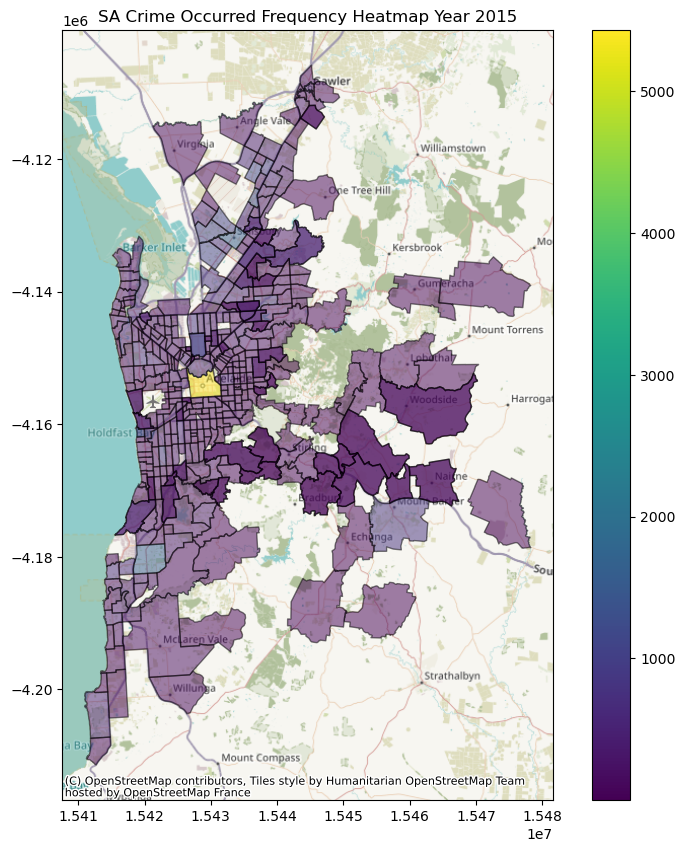

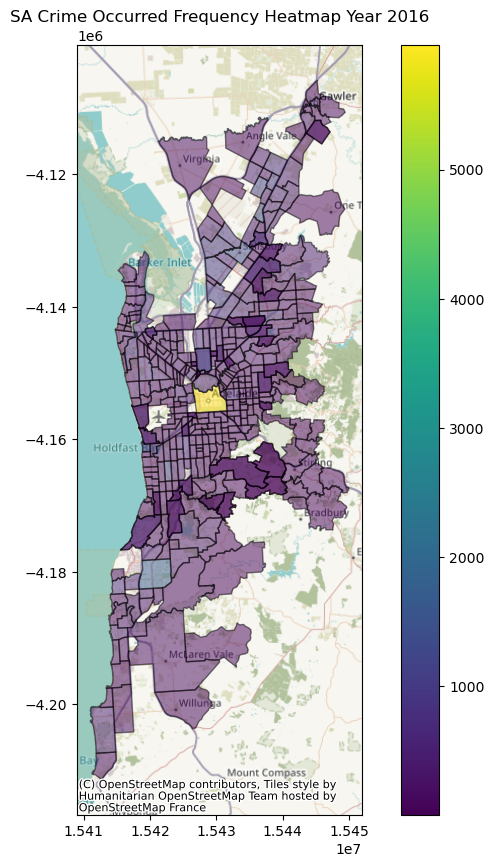

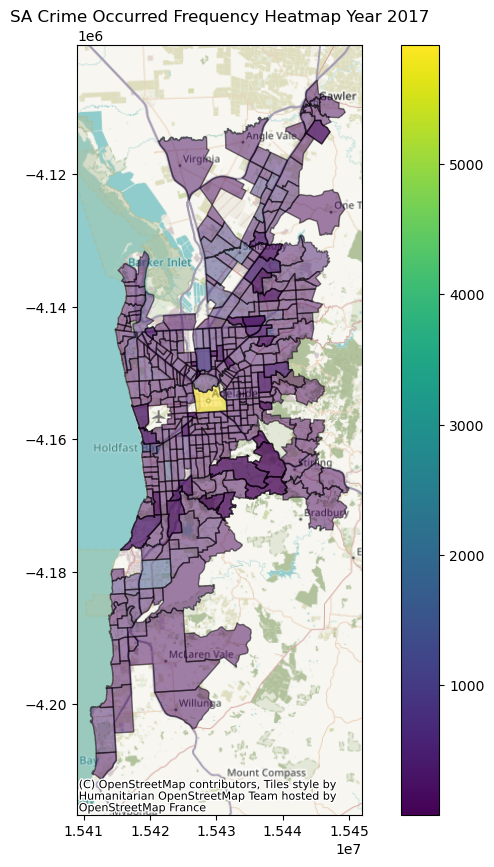

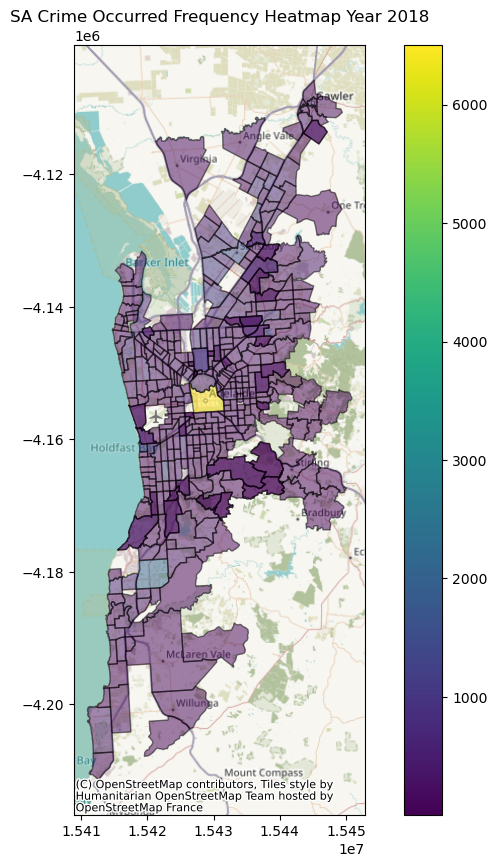

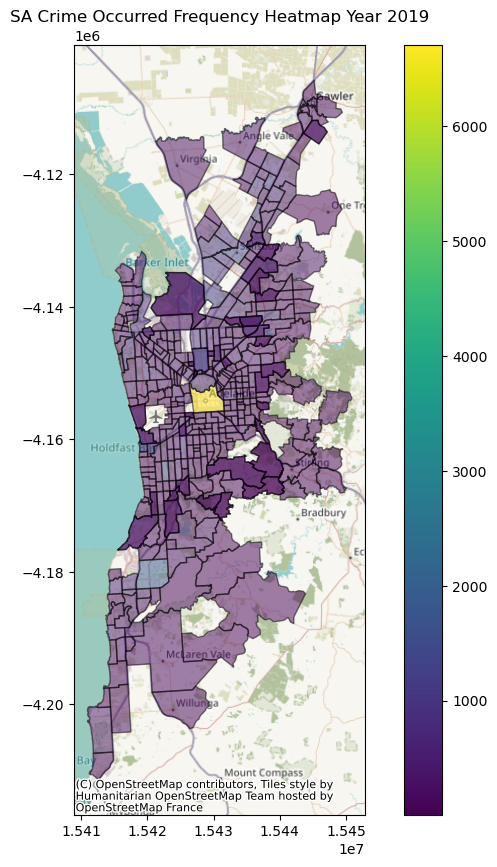

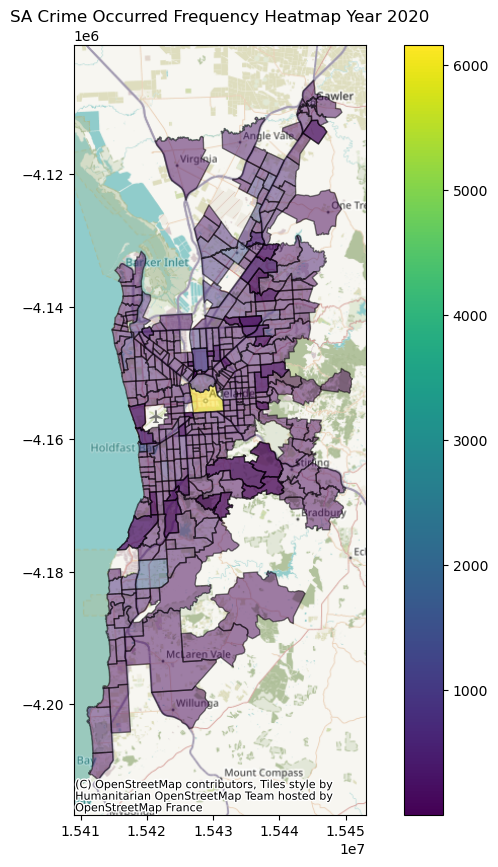

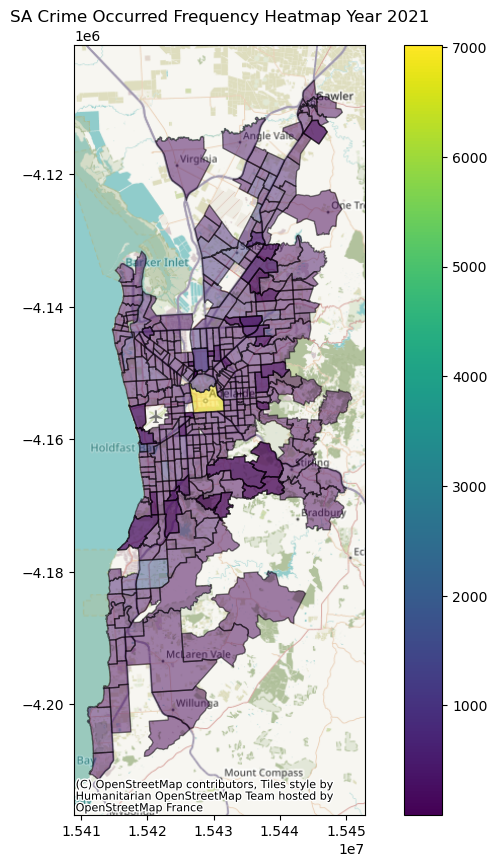

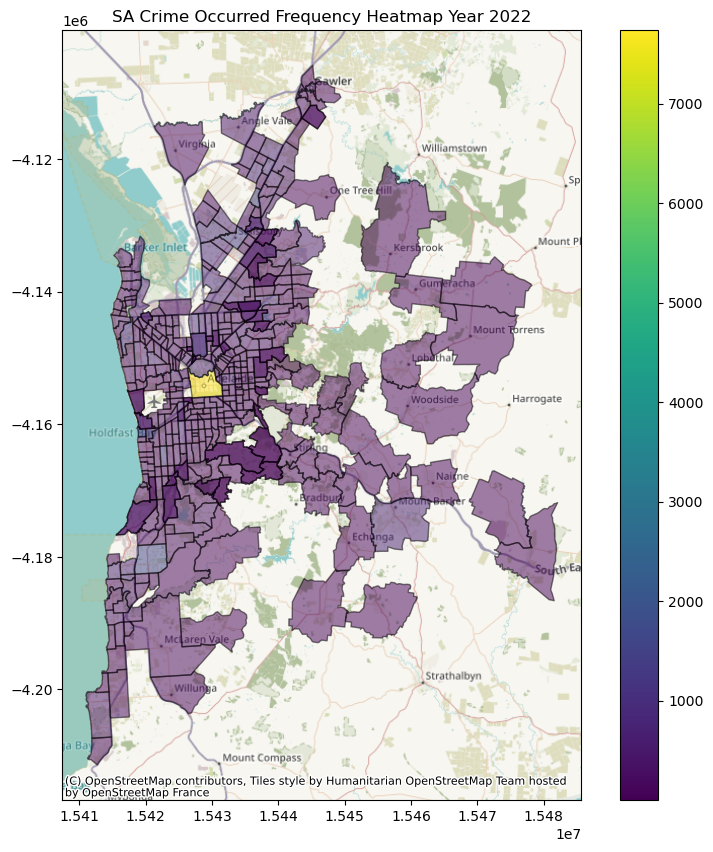

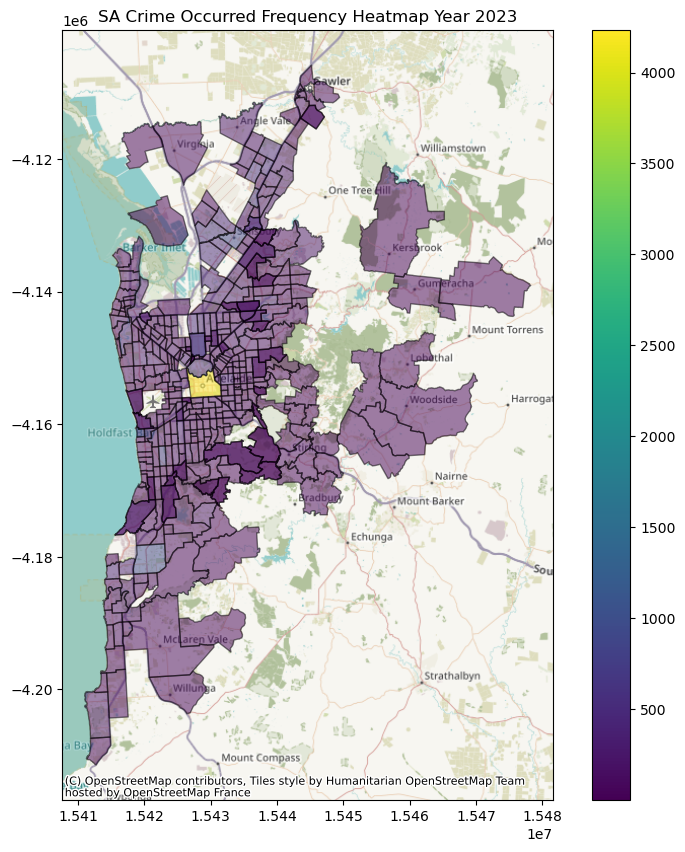

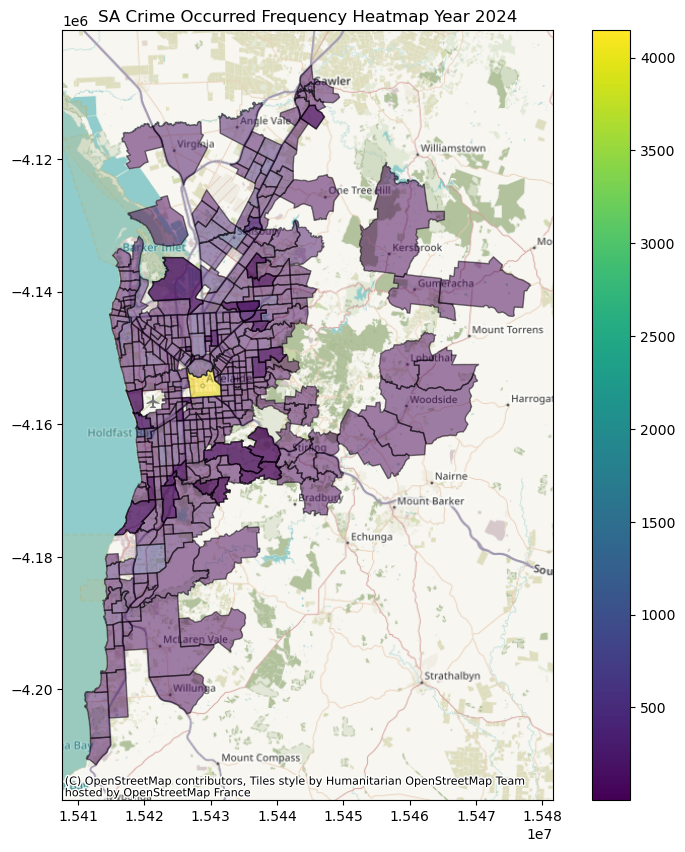

In [118]:
for year in years:
    gdf_year = gdf_crime_house_year.where(gdf_crime_house_year['year'] == year).to_crs(epsg=3857)
    ax = gdf_year.plot(column='offence_count', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
    plt.title(f"SA Crime Occurred Frequency Heatmap Year {year}")
    cx.add_basemap(ax)

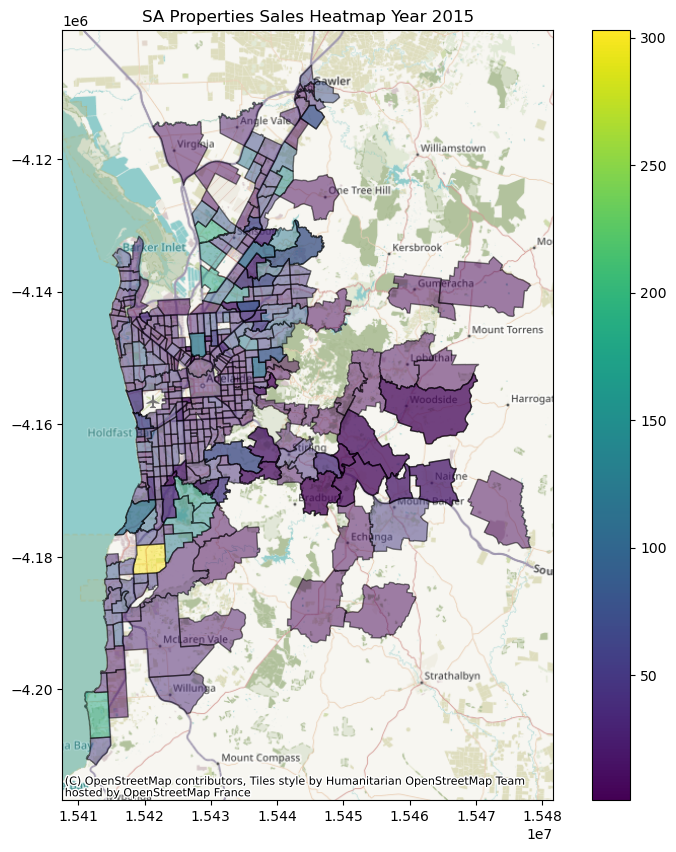

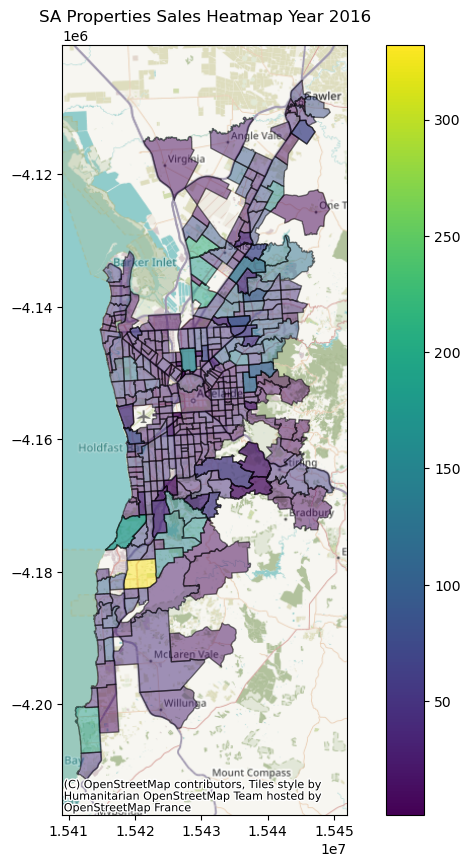

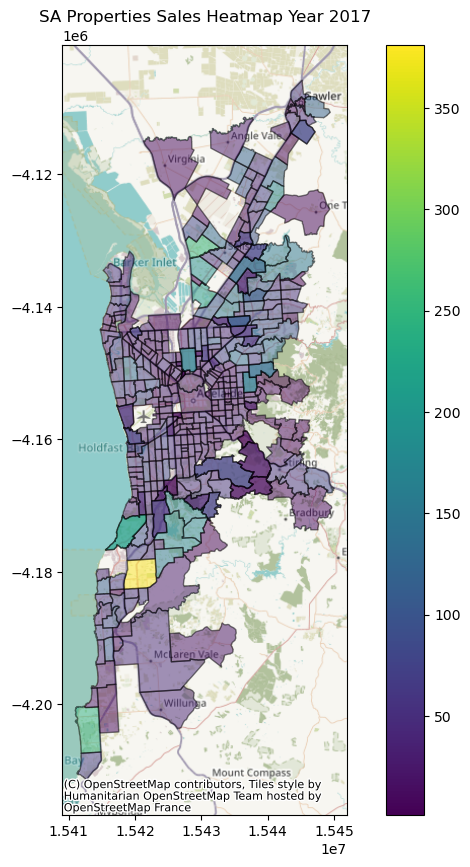

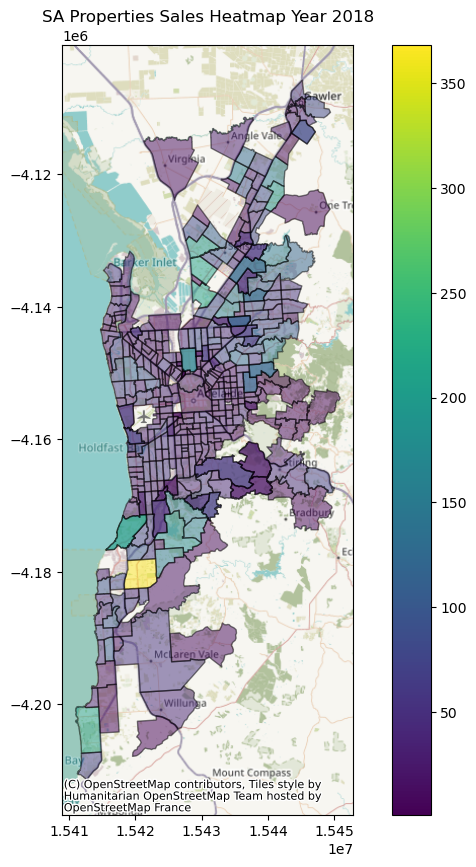

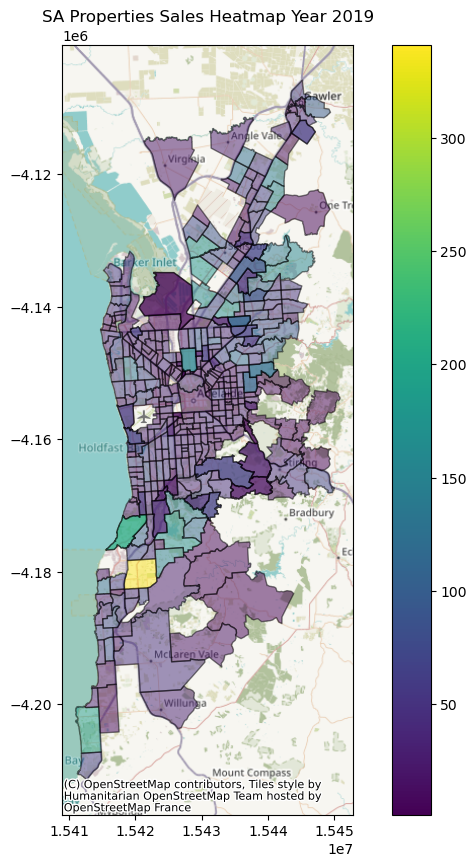

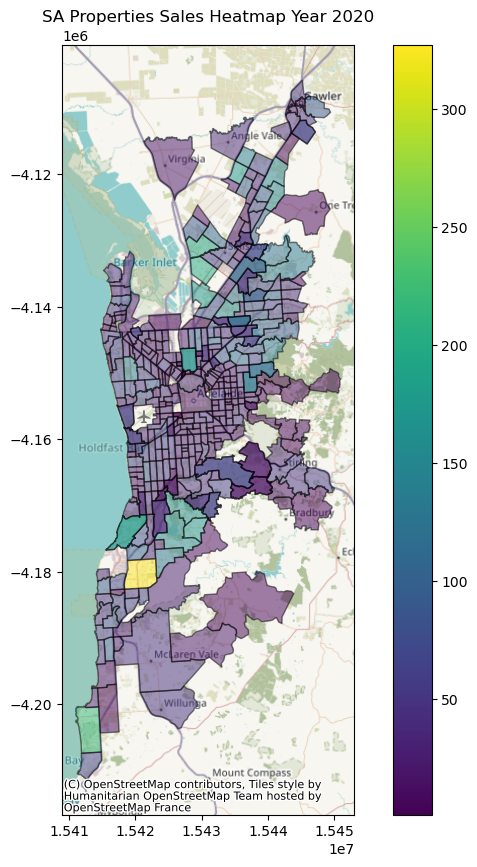

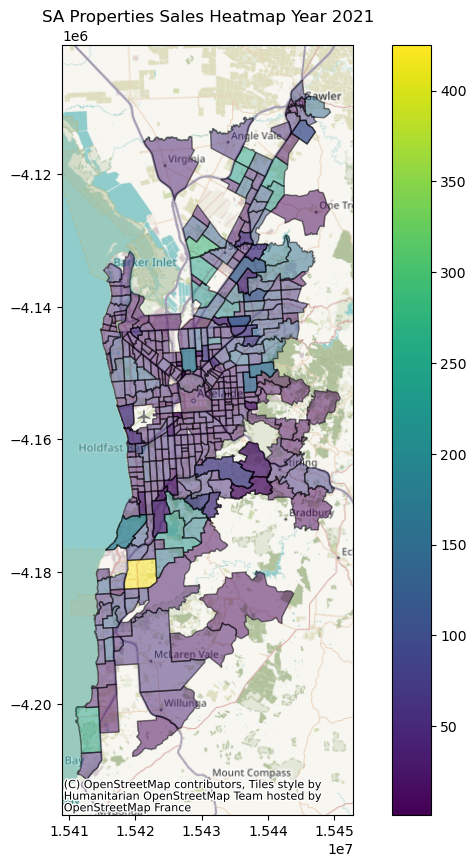

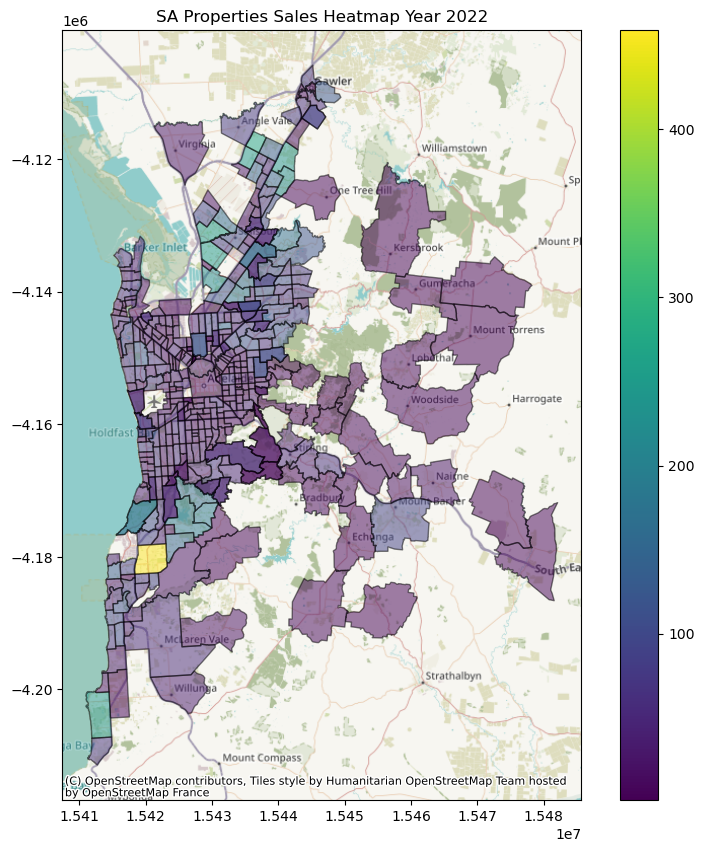

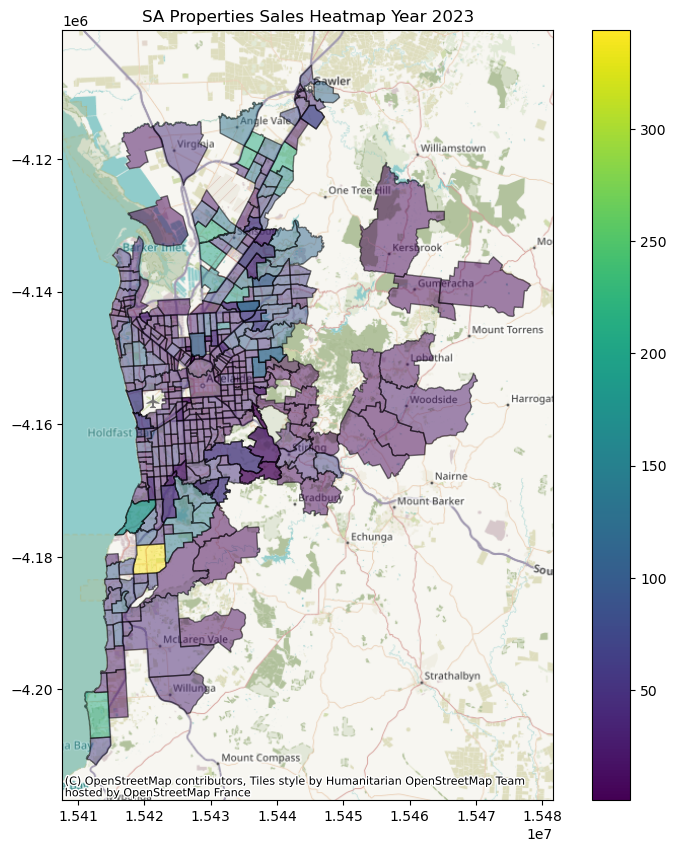

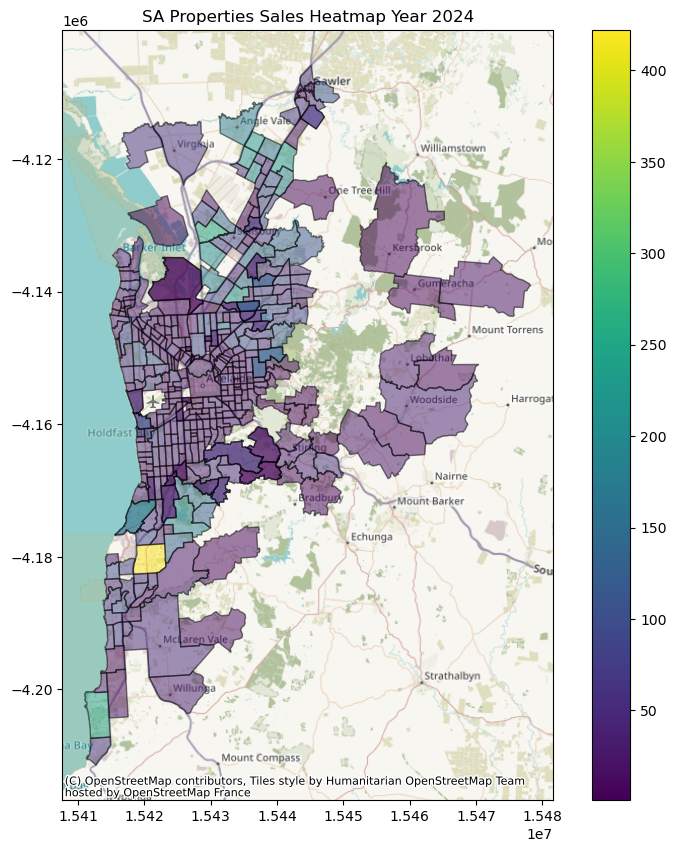

In [119]:
for year in years:
    gdf_year = gdf_crime_house_year.where(gdf_crime_house_year['year'] == year).to_crs(epsg=3857)
    ax = gdf_year.plot(column='sales', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
    plt.title(f"SA Properties Sales Heatmap Year {year}")
    cx.add_basemap(ax)

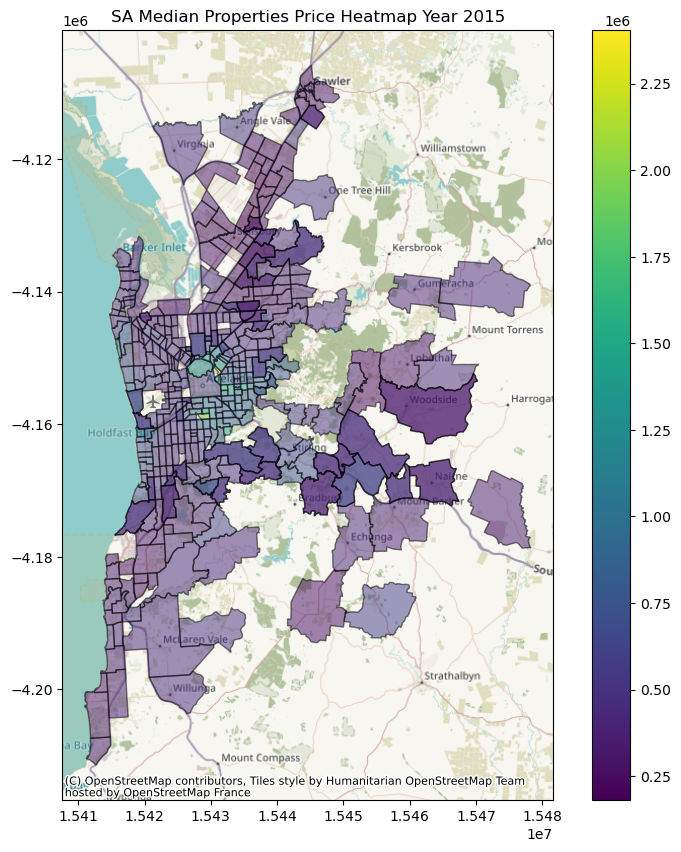

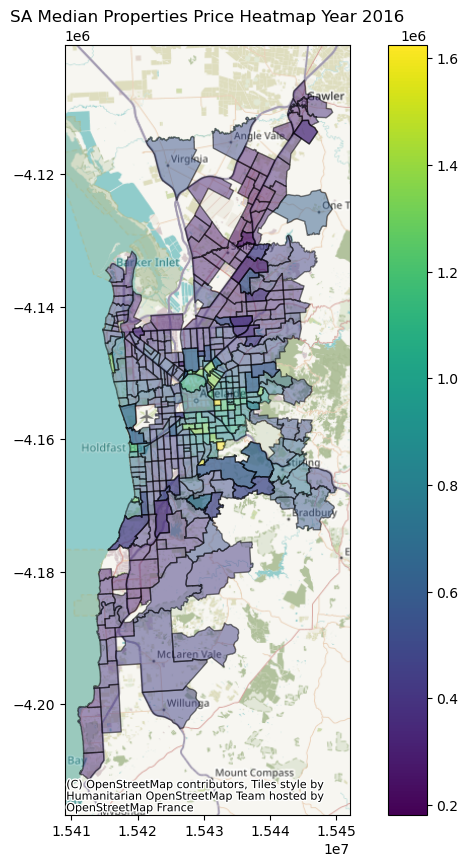

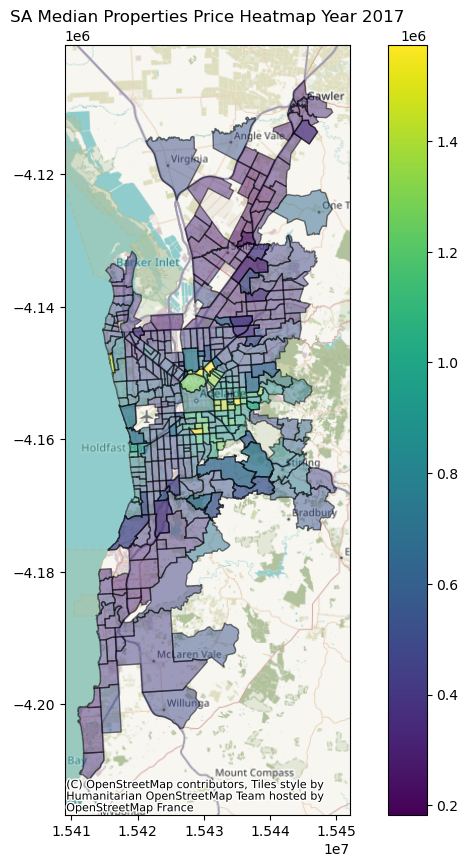

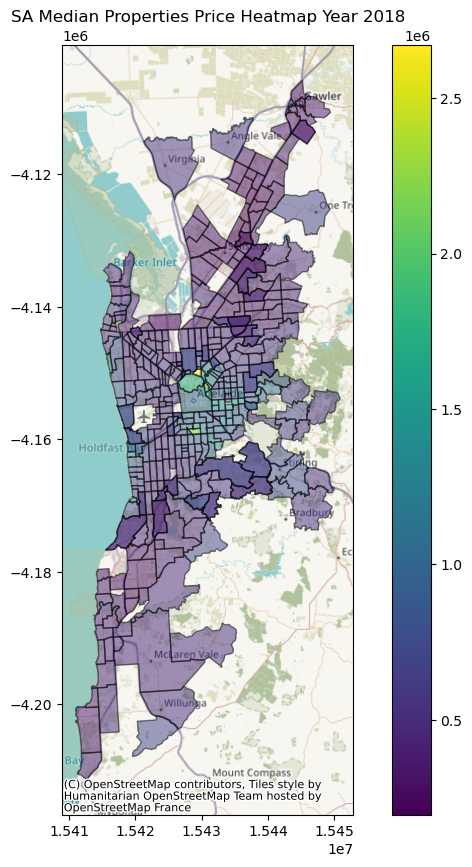

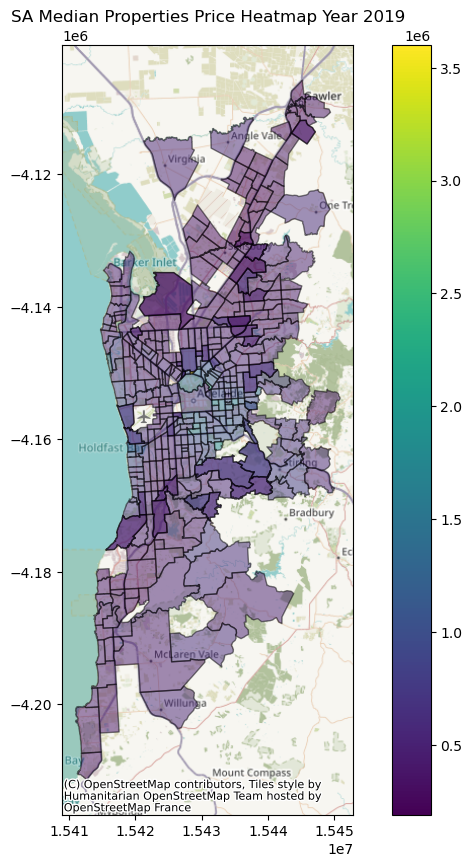

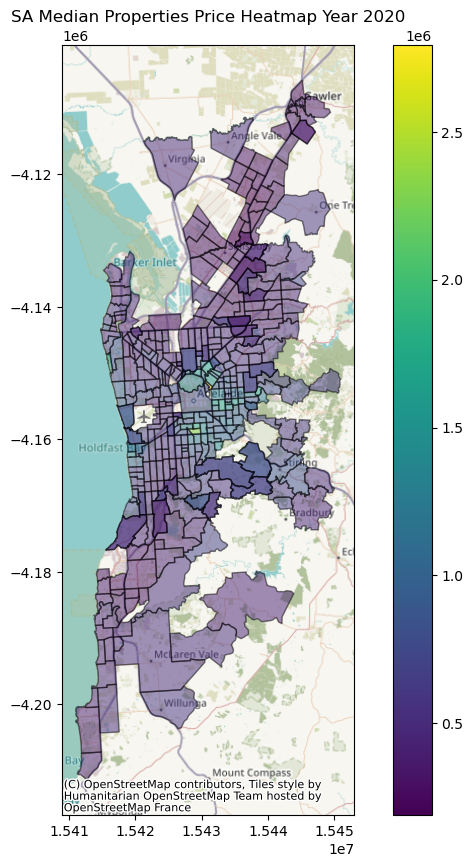

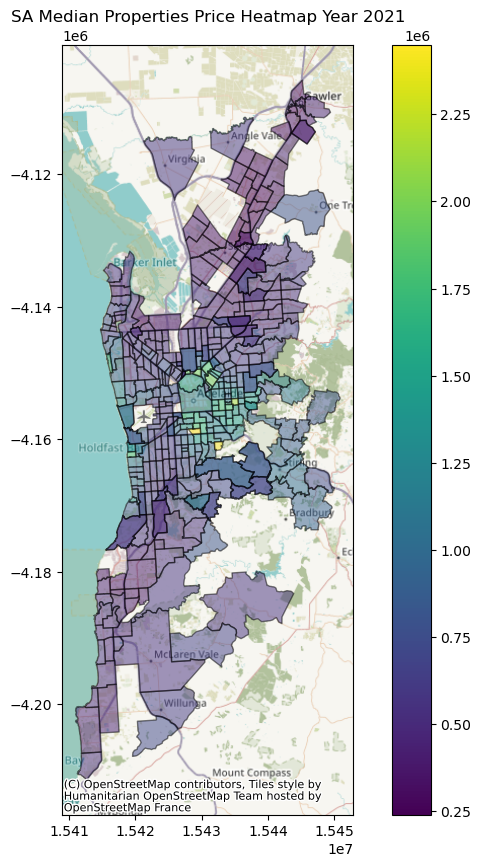

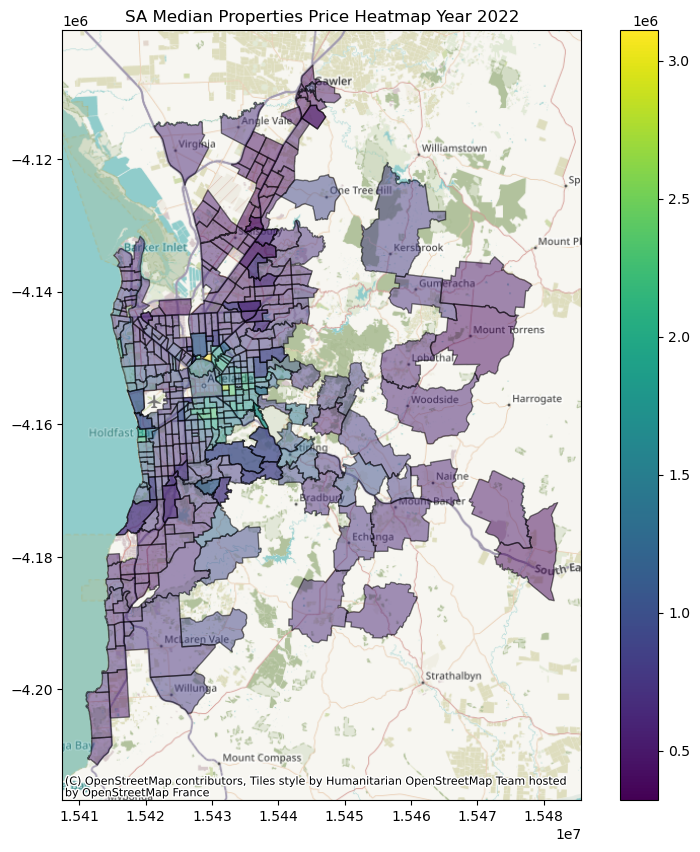

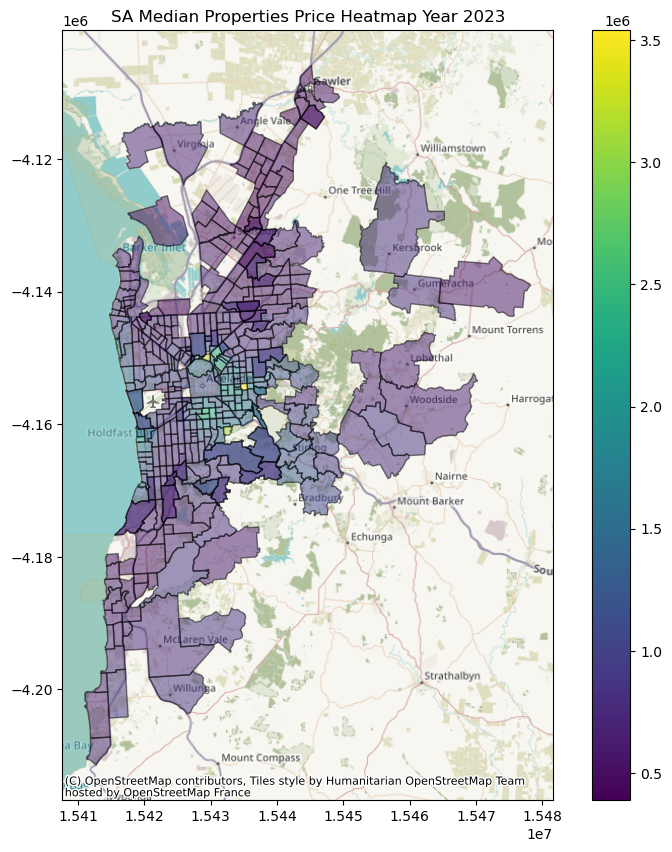

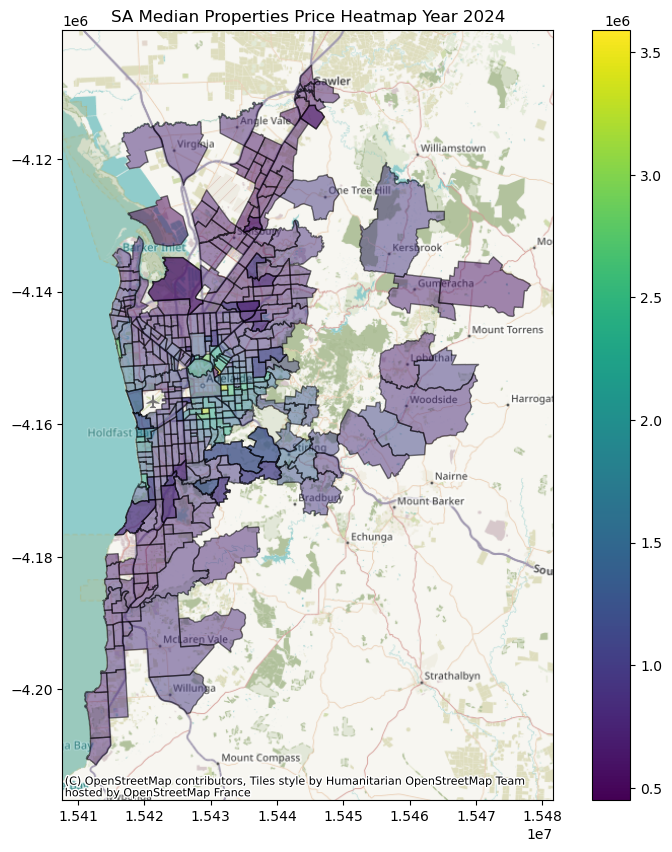

In [120]:
for year in years:
    gdf_year = gdf_crime_house_year.where(gdf_crime_house_year['year'] == year).to_crs(epsg=3857)
    ax = gdf_year.plot(column='median', figsize=(10, 10), alpha=0.5, edgecolor="k", cmap="viridis", legend=True)
    plt.title(f"SA Median Properties Price Heatmap Year {year}")
    cx.add_basemap(ax)